In [1]:
cd lag-llama

D:\jupyter\lag-llama-git\lag-llama


In [2]:
#pip install -r requirements.txt

In [3]:
#!pip install pandas==2.0.3
#!pip install gluonts==0.14.4

In [4]:
!huggingface-cli download time-series-foundation-models/Lag-Llama lag-llama.ckpt --local-dir .

lag-llama.ckpt


In [5]:
from gluonts.torch import TemporalFusionTransformerEstimator, DeepAREstimator
from gluonts.evaluation import make_evaluation_predictions, Evaluator
from gluonts.evaluation import make_evaluation_predictions
from lag_llama.gluon.estimator import LagLlamaEstimator
from sklearn.model_selection import train_test_split
from gluonts.dataset.pandas import PandasDataset
from tqdm.autonotebook import tqdm
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
from itertools import islice
import pandas as pd
import warnings
import torch

In [6]:
warnings.simplefilter("ignore", UserWarning)

In [7]:
dataset = pd.read_csv('../Top_Dataset/scraping/top_18_stock.csv', index_col=0, parse_dates=True)
dataset = dataset.iloc[:, :9]

In [8]:
dataset

,BBCA,BBRI,BMRI,BYAN,TPIA,TLKM,BBNI,ASII,ICBP
2020-02-03,32200,4460,7500,15200,8750,3740,7125,6275,11400
2020-02-04,33000,4560,7525,15200,8750,3760,7350,6400,11600
2020-02-05,33650,4560,7700,15200,8725,3770,7425,6400,11500
2020-02-06,33700,4550,7700,15200,8725,3760,7350,6500,11500
2020-02-07,33800,4550,7725,15200,8800,3790,7350,6400,11500
...,...,...,...,...,...,...,...,...,...
2024-06-03,9275,4530,6100,18000,9200,2930,4620,4500,10200
2024-06-04,9350,4450,6150,17850,9600,3000,4640,4580,10325
2024-06-05,9450,4400,6000,17875,8650,3060,4610,4600,10450
2024-06-06,9475,4500,6175,17800,8700,3050,4770,4560,10600


In [9]:
len(dataset)

1135

In [10]:
#total_data = len(dataset )
#train      = int(0.7 * total_data)
#test       = total_data - train_data

#train_data = data.iloc[:train]
#test_data  = data.iloc[test:]

# Splitting data training (70%), testing data (30%).
train_data, test_data = train_test_split(dataset, test_size=0.3, shuffle=False)

print("Train data:", len(train_data))
print("Test data:", len(test_data))

Train data: 794
Test data: 341


In [11]:
freq_1 = pd.infer_freq(train_data.index)
freq_2 = pd.infer_freq(test_data.index)

print(f"frequency used train data: {freq_1}")
print(f"frequency used test data: {freq_2}")

frequency used train data: B
frequency used test data: B


In [12]:
prediction_length =32
num_samples=20
batch_size=64
epoch=50

# **Function**

In [13]:
def preprocess_dataset(data):
    for col in data.columns:
        if data[col].dtype != 'object' and not pd.api.types.is_string_dtype(data[col]):
            data[col] = data[col].astype('float32')
    return PandasDataset(dict(data))

backtrain_dataset = preprocess_dataset(train_data)
backtest_dataset  = preprocess_dataset(test_data)

### Function Lag-Llama Zero-Shot

In [14]:
def lag_llama_zero_shot(context_length, use_rope_scaling):
    
    ckpt = torch.load("lag-llama.ckpt", map_location="cuda")
    estimator_args = ckpt["hyper_parameters"]["model_kwargs"]

    rope_scaling_arguments = {
        "type": "linear",
        "factor": max(1.0, (context_length + prediction_length) / estimator_args["context_length"]),
    }

    estimator = LagLlamaEstimator(
        ckpt_path="lag-llama.ckpt",
        prediction_length=prediction_length,
        context_length=context_length,
        input_size=estimator_args["input_size"],
        n_layer=estimator_args["n_layer"],
        n_embd_per_head=estimator_args["n_embd_per_head"],
        n_head=estimator_args["n_head"],
        scaling=estimator_args["scaling"],
        time_feat=estimator_args["time_feat"],
        rope_scaling=rope_scaling_arguments if use_rope_scaling else None,
        batch_size=batch_size,
        num_parallel_samples=num_samples
    )

    lightning_module = estimator.create_lightning_module()
    transformation = estimator.create_transformation()
    predictor = estimator.create_predictor(transformation, lightning_module)

    forecast_zero_shot_it, ts_zero_shot_it = make_evaluation_predictions(
        dataset=backtest_dataset,
        predictor=predictor,
        num_samples=num_samples
    )
    zero_shot_forecasts = list(forecast_zero_shot_it)
    zero_shot_tss = list(ts_zero_shot_it)

    evaluator = Evaluator()
    agg_metrics, ts_metrics = evaluator(iter(zero_shot_tss), iter(zero_shot_forecasts))

    return zero_shot_forecasts, zero_shot_tss, agg_metrics

In [15]:
def print_crps_zero_shot(context_length, use_rope_scaling, agg_metrics):
    crps = agg_metrics['mean_wQuantileLoss']
    print(f"Lag-Llama Zero-Shot ({context_length}) rope_scaled ({use_rope_scaling}) CRPS: {crps:.4f}")
    return crps

### Function Lag-Llama Fine-Tuning

In [16]:
def lag_llama_fine_tuning(context_length, lr):
    ckpt = torch.load("lag-llama.ckpt", map_location="cuda")
    estimator_args = ckpt["hyper_parameters"]["model_kwargs"]

    estimator = LagLlamaEstimator(
        ckpt_path="lag-llama.ckpt",
        prediction_length=prediction_length,
        context_length=context_length,
        nonnegative_pred_samples=True,
        
        aug_prob=0,
        lr=lr,
        
        input_size=estimator_args["input_size"],
        n_layer=estimator_args["n_layer"],
        n_embd_per_head=estimator_args["n_embd_per_head"],
        n_head=estimator_args["n_head"],
        time_feat=estimator_args["time_feat"],
        
        batch_size=batch_size,
        num_parallel_samples=num_samples,
        trainer_kwargs={"max_epochs": epoch},
    )

    predictor = estimator.train(
        backtrain_dataset,
        cache_data=True,
        shuffle_buffer_length=1000
    )

    fine_tuning_forecast_it, fine_tuning_ts_it = make_evaluation_predictions(
        dataset=backtest_dataset,
        predictor=predictor,
        num_samples=num_samples
    )

    fine_tuning_forecasts = list(fine_tuning_forecast_it)
    fine_tuning_tss = list(fine_tuning_ts_it)

    evaluator = Evaluator()
    agg_metrics, ts_metrics = evaluator(iter(fine_tuning_tss), iter(fine_tuning_forecasts))

    return fine_tuning_forecasts, fine_tuning_tss, agg_metrics

In [17]:
def print_crps_fine_tuning(context_length, lr, agg_metrics):
    crps = agg_metrics['mean_wQuantileLoss']
    print(f"Lag-Llama Fine-Tuning ({context_length}) Lr {lr} CRPS: {crps:.4f}")
    return crps

### Function Plotting

In [18]:
def plotting(forecasts, tss):
    plt.figure(figsize=(20, 15))
    date_formatter = mdates.DateFormatter('%d-%m-%Y')
    plt.rcParams.update({'font.size': 15})

    for idx, (forecast, ts) in islice(enumerate(zip(forecasts, tss)), 9):
        ax = plt.subplot(3, 3, idx+1)
        plt.plot(ts[-4 * prediction_length:].to_timestamp(), label="target")
        forecast.plot(color='g')
        plt.xticks(rotation=60)
        ax.xaxis.set_major_formatter(date_formatter)
        ax.set_title(forecast.item_id)

    plt.gcf().tight_layout()
    plt.legend()
    plt.show()

# **Lag-Llama Zero-Shot**

## Zero-Shot Forecasting: Tuning the context length

### Get predictions with the default context length ***(32)***

In [19]:
forecasts_zero_shot_len_32_false, tss_zero_shot_len_32_false, agg_metrics = lag_llama_zero_shot(32, False)
zero_shot_len_32_false = print_crps_zero_shot(32, False, agg_metrics)

Running evaluation: 9it [00:00, 287.98it/s]

Lag-Llama Zero-Shot (32) rope_scaled (False) CRPS: 0.0890


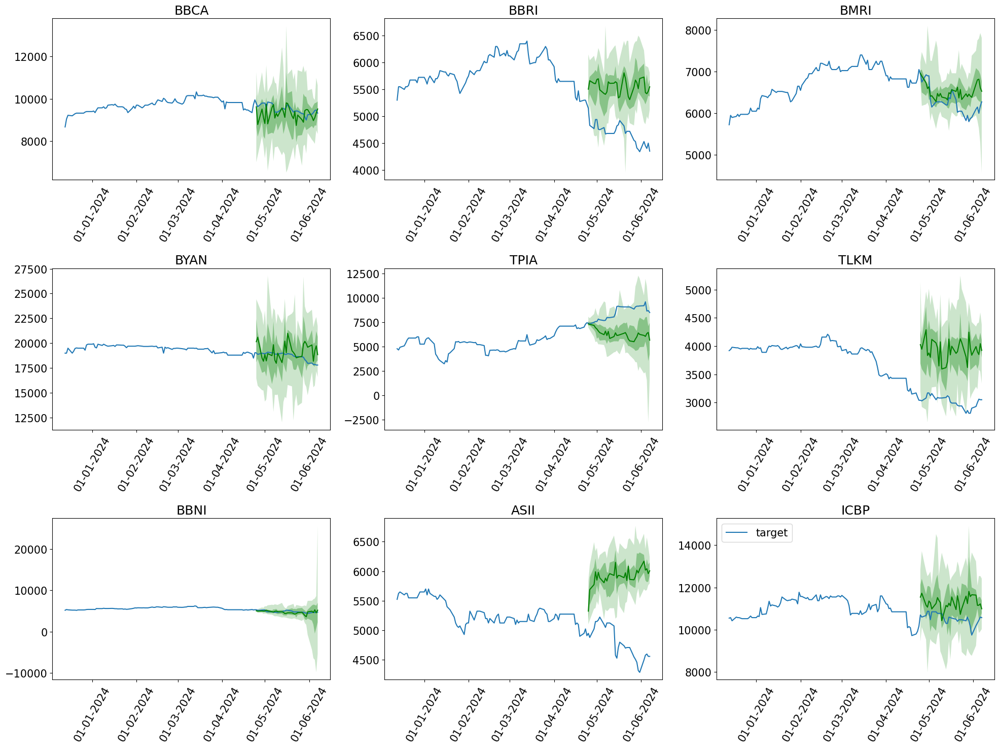

In [20]:
plotting(forecasts_zero_shot_len_32_false, tss_zero_shot_len_32_false)

### Get predictions with the default context length ***(64)***

In [21]:
forecasts_zero_shot_len_64_false, tss_zero_shot_len_64_false, agg_metrics = lag_llama_zero_shot(64, False)
zero_shot_len_64_false = print_crps_zero_shot(64, False, agg_metrics)

Running evaluation: 9it [00:00, 274.77it/s]

Lag-Llama Zero-Shot (64) rope_scaled (False) CRPS: 0.0980


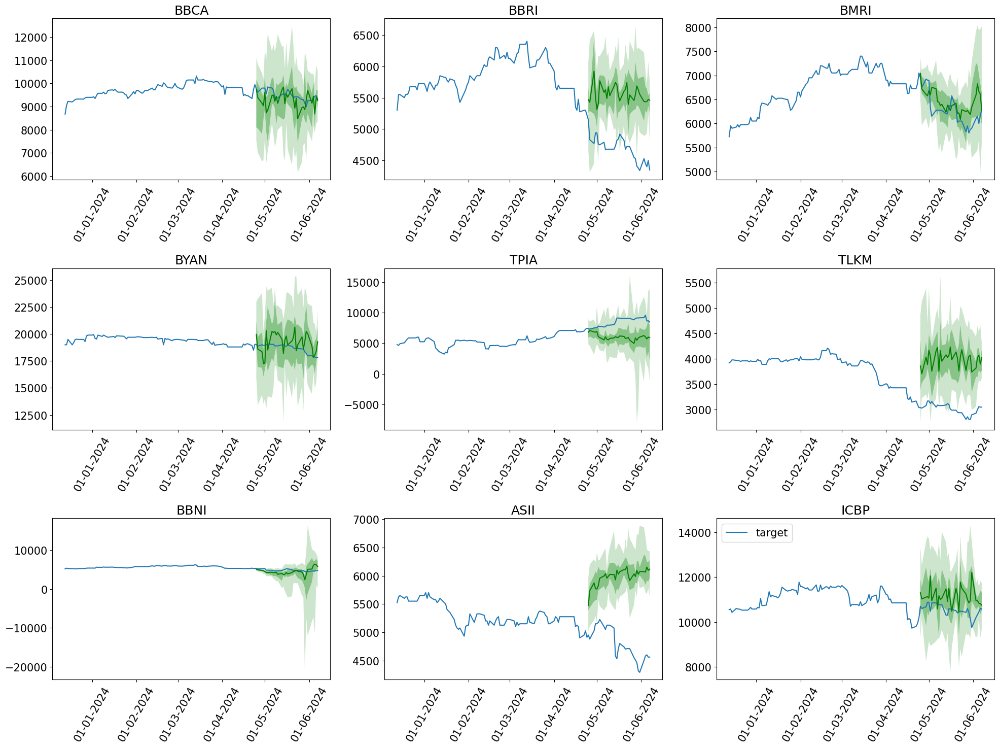

In [22]:
plotting(forecasts_zero_shot_len_64_false, tss_zero_shot_len_64_false)

Now enable **RoPE scaling** which better equips the model in handling large context lengths (larger than 32 in this case). This is done by passing `use_rope_scaling=True` to the `get_lag_llama_predictions` function.

In [23]:
forecasts_zero_shot_len_64_true, tss_zero_shot_len_64_true, agg_metrics = lag_llama_zero_shot(64, True)
zero_shot_len_64_true = print_crps_zero_shot(64, True, agg_metrics)

Running evaluation: 9it [00:00, 293.81it/s]

Lag-Llama Zero-Shot (64) rope_scaled (True) CRPS: 0.0927


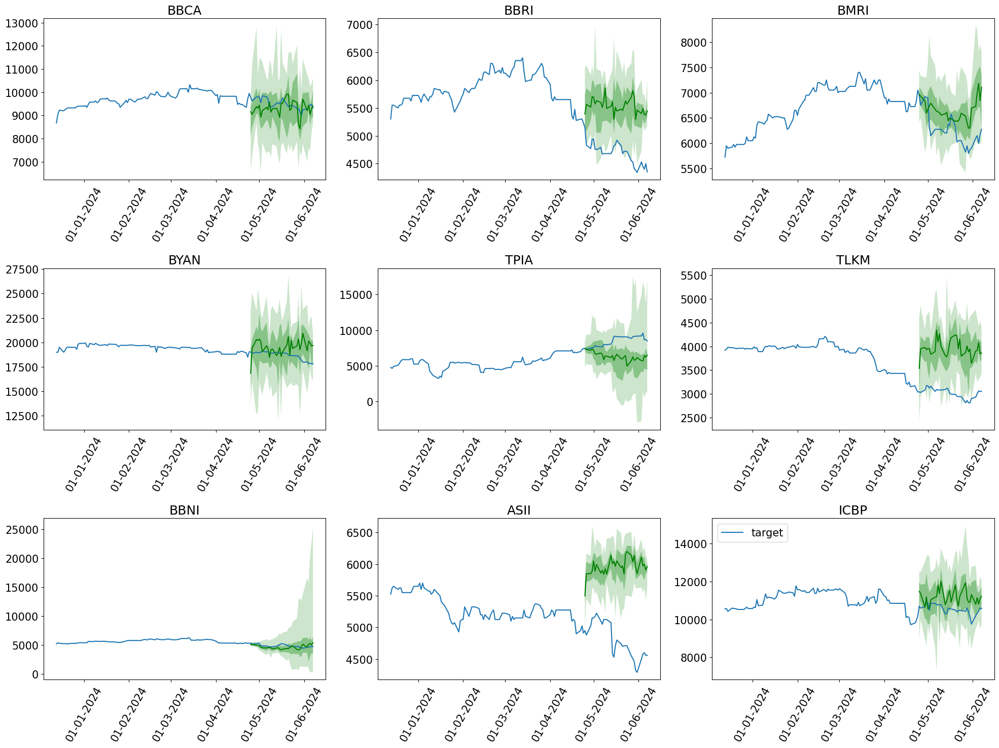

In [24]:
plotting(forecasts_zero_shot_len_64_true, tss_zero_shot_len_64_true)

### Get predictions with the default context length ***(128)***

In [25]:
forecasts_zero_shot_len_128_true, tss_zero_shot_len_128_true, agg_metrics = lag_llama_zero_shot(128, True)
zero_shot_len_128_true = print_crps_zero_shot(128, True, agg_metrics)

Running evaluation: 9it [00:00, 287.98it/s]

Lag-Llama Zero-Shot (128) rope_scaled (True) CRPS: 0.0890


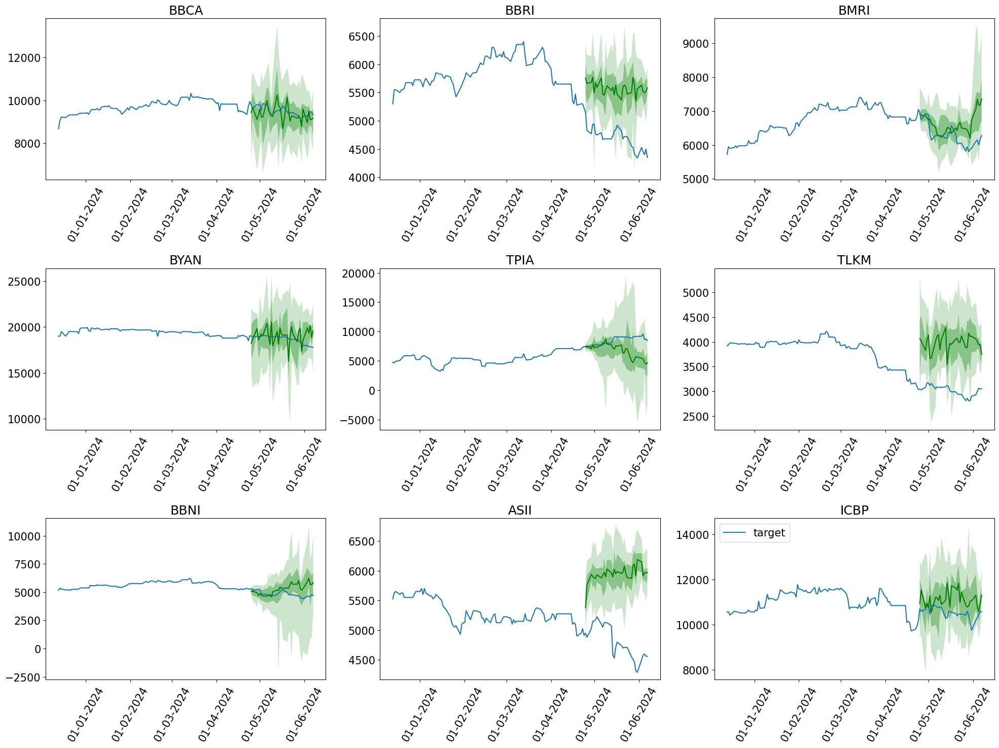

In [26]:
plotting(forecasts_zero_shot_len_128_true, tss_zero_shot_len_128_true)

### Get predictions with the default context length ***(256)***

In [27]:
forecasts_zero_shot_len_256_true, tss_zero_shot_len_256_true, agg_metrics = lag_llama_zero_shot(256, True)
zero_shot_len_256_true = print_crps_zero_shot(256, True, agg_metrics)

Running evaluation: 9it [00:00, 232.21it/s]

Lag-Llama Zero-Shot (256) rope_scaled (True) CRPS: 0.0973


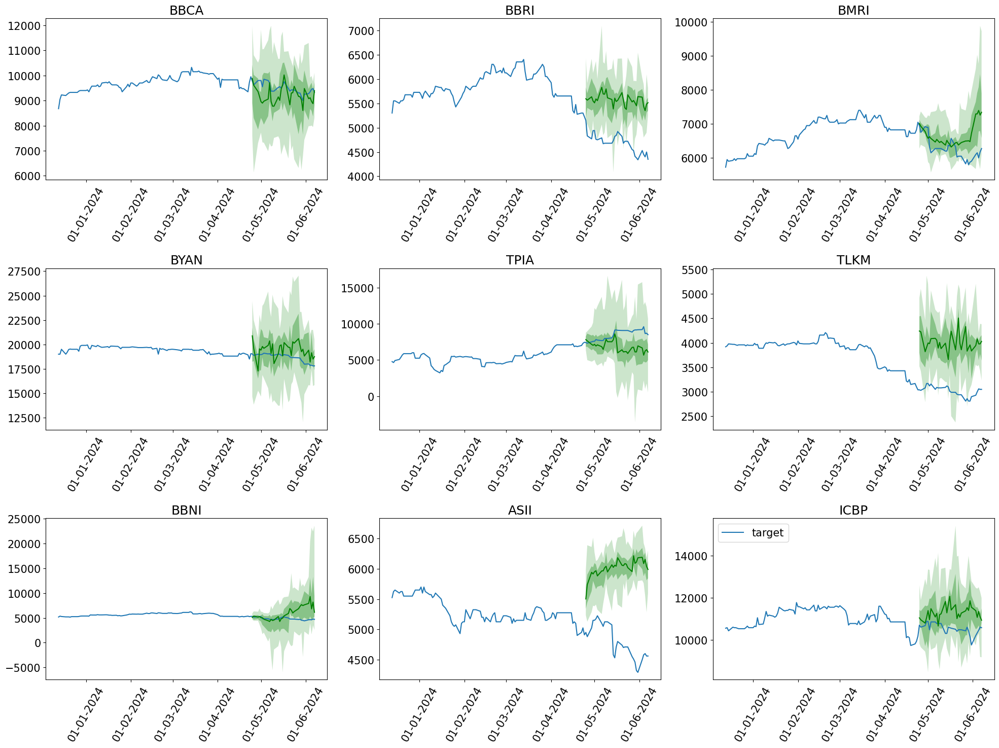

In [28]:
plotting(forecasts_zero_shot_len_256_true, tss_zero_shot_len_256_true)

### Get predictions with the default context length ***(512)***

In [29]:
forecasts_zero_shot_len_512_true, tss_zero_shot_len_512_true, agg_metrics = lag_llama_zero_shot(512, True)
zero_shot_len_512_true = print_crps_zero_shot(512, True, agg_metrics)

Running evaluation: 9it [00:00, 287.96it/s]

Lag-Llama Zero-Shot (512) rope_scaled (True) CRPS: 0.1330


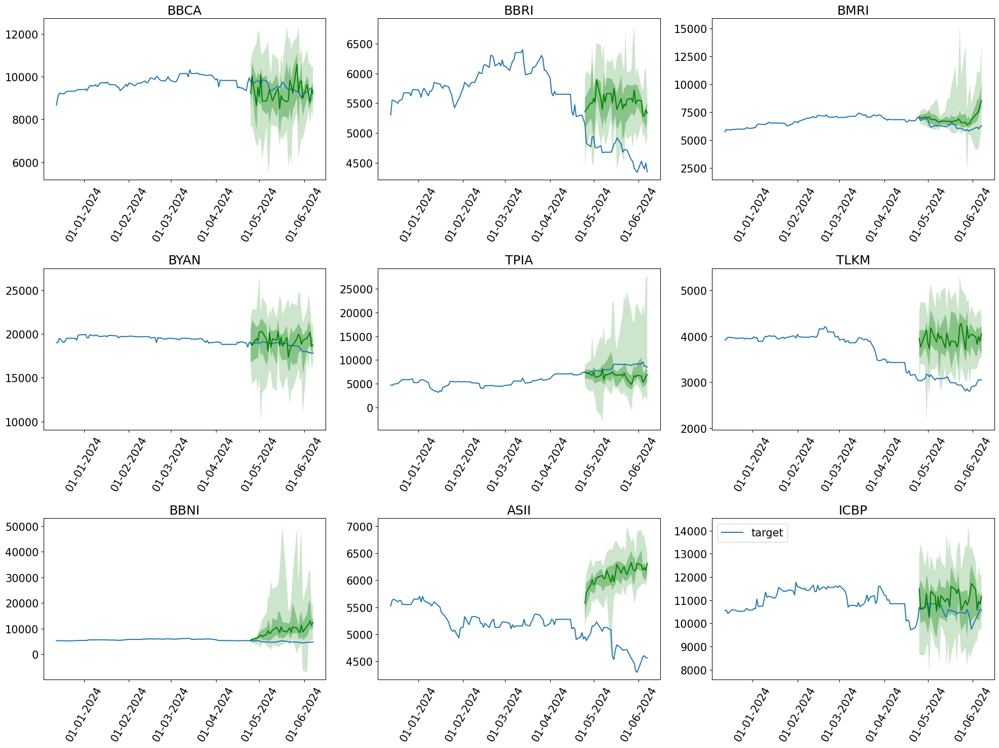

In [30]:
plotting(forecasts_zero_shot_len_512_true, tss_zero_shot_len_512_true)

### Get predictions with the default context length ***(1024)***

In [31]:
forecasts_zero_shot_len_1024_true, tss_zero_shot_len_1024_true, agg_metrics = lag_llama_zero_shot(1024, True)
zero_shot_len_1024_true = print_crps_zero_shot(1024, True, agg_metrics)

Running evaluation: 9it [00:00, 287.91it/s]

Lag-Llama Zero-Shot (1024) rope_scaled (True) CRPS: 0.1515


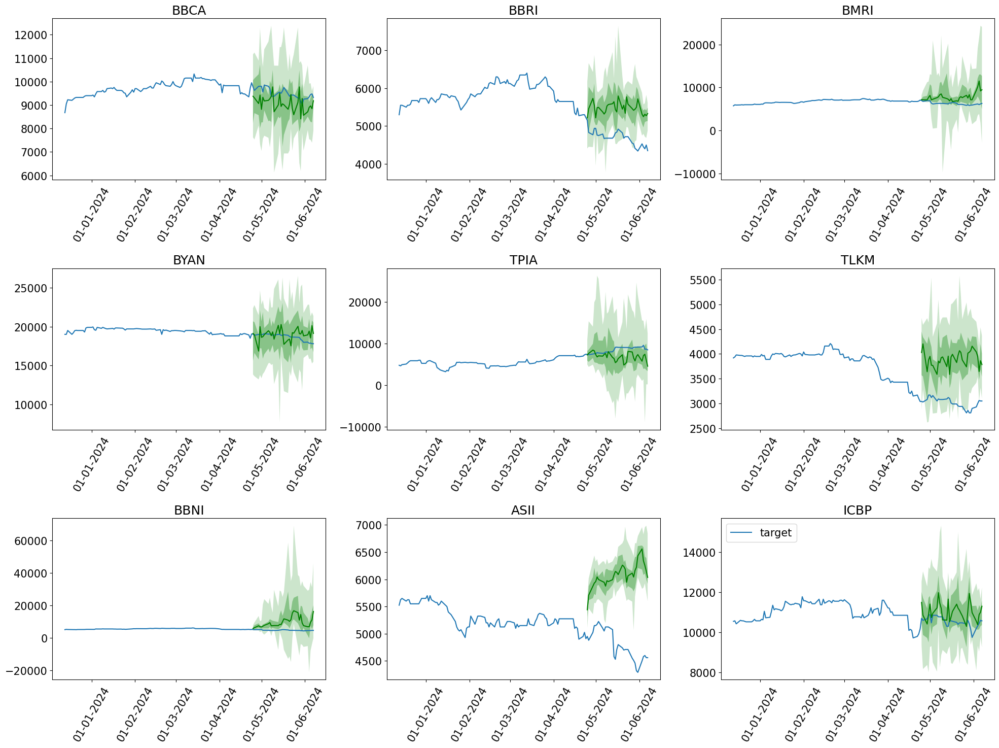

In [32]:
plotting(forecasts_zero_shot_len_1024_true, tss_zero_shot_len_1024_true)

# **Lag-Llama Fine-Tuning**

### ***Learning Rate 1e-2***

### Get predictions with the default context length ***(32)***

In [33]:
forecasts_fine_tuning_len_32_lr_1e_2, tss_fine_tuning_len_32_lr_1e_2, agg_metrics = lag_llama_fine_tuning(32, 1e-2)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 4090') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 11.25971 (best 11.25971), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_248\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 9.26429 (best 9.26429), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_248\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 9.24374 (best 9.24374), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_248\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 9.05174 (best 9.05174), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_248\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 9.05053 (best 9.05053), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_248\\checkpoints\\epoch=4-step=250.ckpt' as t

In [34]:
fine_tuning_len_32_lr_1e_2 = print_crps_fine_tuning(32, 1e-2, agg_metrics)

Lag-Llama Fine-Tuning (32) Lr 0.01 CRPS: 0.0674


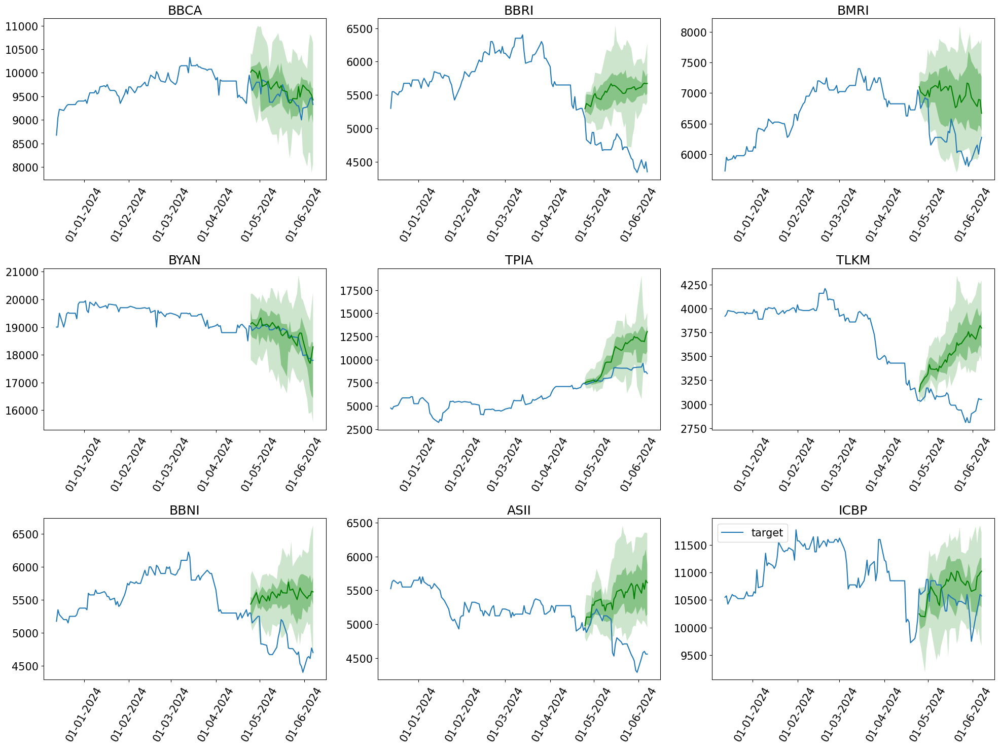

In [35]:
plotting(forecasts_fine_tuning_len_32_lr_1e_2, tss_fine_tuning_len_32_lr_1e_2)

### Get predictions with the default context length ***(64)***

In [36]:
forecasts_fine_tuning_len_64_lr_1e_2, tss_fine_tuning_len_64_lr_1e_2, agg_metrics = lag_llama_fine_tuning(64, 1e-2)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 11.06210 (best 11.06210), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_249\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 9.83621 (best 9.83621), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_249\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 9.05100 (best 9.05100), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_249\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 9.03925 (best 9.03925), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_249\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 9.03580 (best 9.03580), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_log

In [37]:
fine_tuning_len_64_lr_1e_2 = print_crps_fine_tuning(64, 1e-2, agg_metrics)

Lag-Llama Fine-Tuning (64) Lr 0.01 CRPS: 0.1220


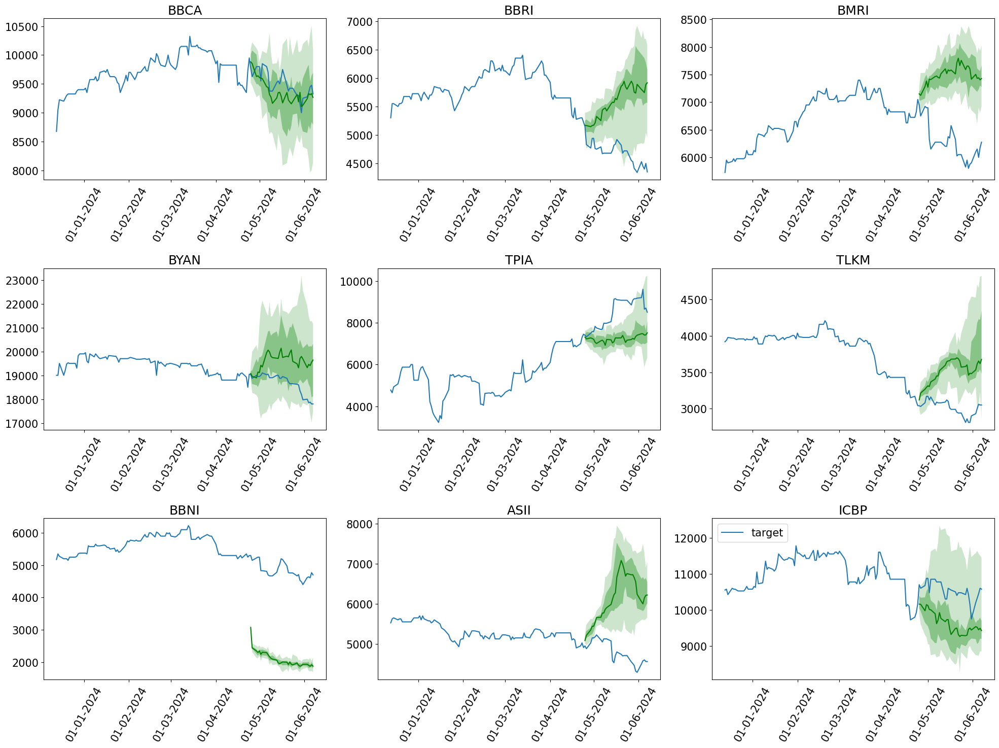

In [38]:
plotting(forecasts_fine_tuning_len_64_lr_1e_2, tss_fine_tuning_len_64_lr_1e_2)

### Get predictions with the default context length ***(128)***

In [39]:
forecasts_fine_tuning_len_128_lr_1e_2, tss_fine_tuning_len_128_lr_1e_2, agg_metrics = lag_llama_fine_tuning(128, 1e-2)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.16132 (best 10.16132), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_250\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 9.04151 (best 9.04151), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_250\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.99446 (best 8.99446), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_250\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 8.92047 (best 8.92047), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_250\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' was not in top 1
Epoch 7, global step 400: 't

In [40]:
fine_tuning_len_128_lr_1e_2 = print_crps_fine_tuning(128, 1e-2, agg_metrics)

Lag-Llama Fine-Tuning (128) Lr 0.01 CRPS: 0.1088


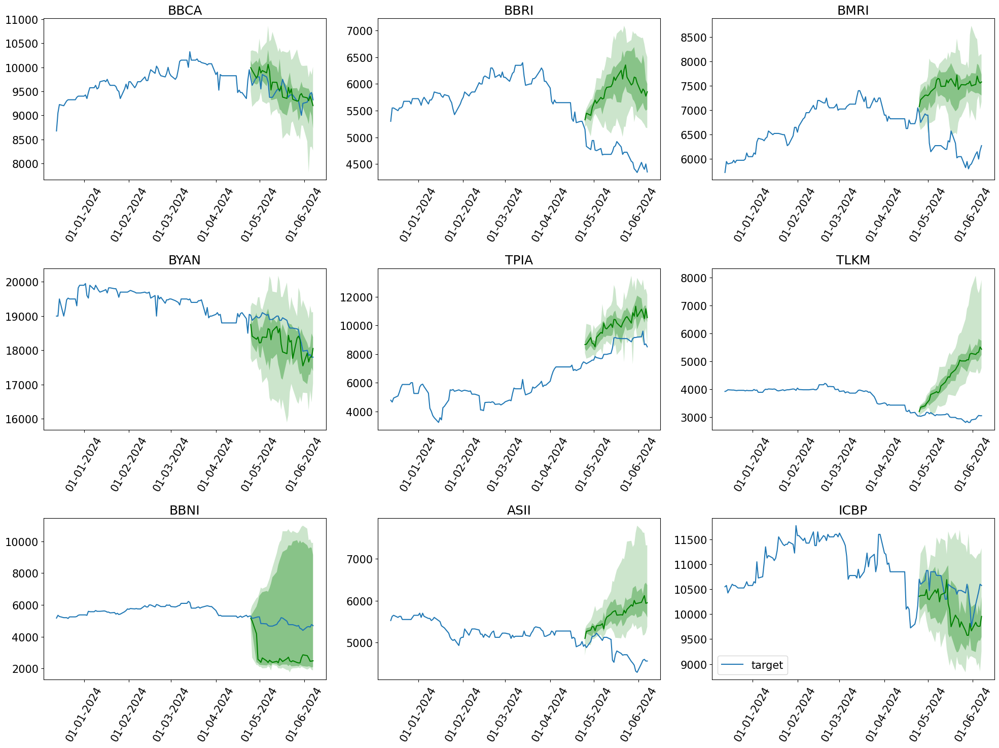

In [41]:
plotting(forecasts_fine_tuning_len_128_lr_1e_2, tss_fine_tuning_len_128_lr_1e_2)

### Get predictions with the default context length ***(256)***

In [42]:
forecasts_fine_tuning_len_256_lr_1e_2, tss_fine_tuning_len_256_lr_1e_2, agg_metrics = lag_llama_fine_tuning(256, 1e-2)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.07531 (best 10.07531), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_251\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.90136 (best 8.90136), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_251\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' was not in top 1
Epoch 3, global step 200: 'train_loss' reached 8.81023 (best 8.81023), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_251\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' reached 8.67917 (best 8.67917), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_251\\checkpoints\\epoch=6-step=350.ckpt' as top 1
Epoch 7, global step 400: 't

In [43]:
fine_tuning_len_256_lr_1e_2 = print_crps_fine_tuning(256, 1e-2, agg_metrics)

Lag-Llama Fine-Tuning (256) Lr 0.01 CRPS: 0.1072


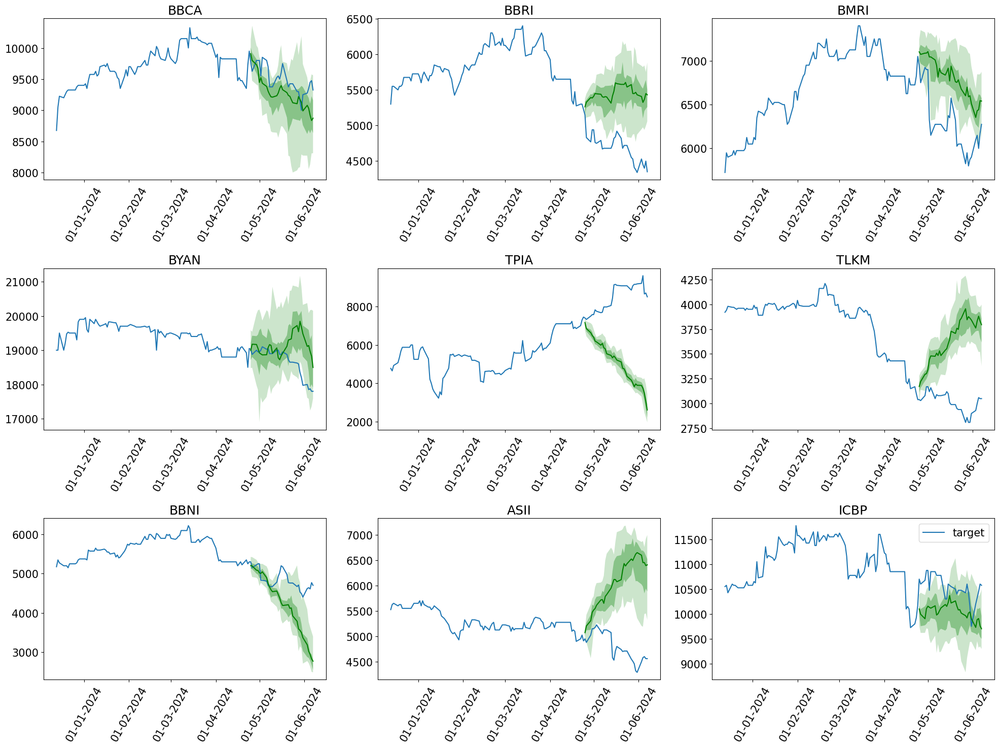

In [44]:
plotting(forecasts_fine_tuning_len_256_lr_1e_2, tss_fine_tuning_len_256_lr_1e_2)

### Get predictions with the default context length ***(512)***

In [45]:
forecasts_fine_tuning_len_512_lr_1e_2, tss_fine_tuning_len_512_lr_1e_2, agg_metrics = lag_llama_fine_tuning(512, 1e-2)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.99299 (best 10.99299), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_252\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 9.16763 (best 9.16763), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_252\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.82639 (best 8.82639), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_252\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' reached 8.68879 (best 8.68879), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_252\\checkpoints\\epoch=5-step=300.ckpt' as top 1
Epoch 6, global step 350: 'train_loss' was not in top 1
Epoch 7, global step 400: 't

In [46]:
fine_tuning_len_512_lr_1e_2 = print_crps_fine_tuning(512, 1e-2, agg_metrics)

Lag-Llama Fine-Tuning (512) Lr 0.01 CRPS: 0.0803


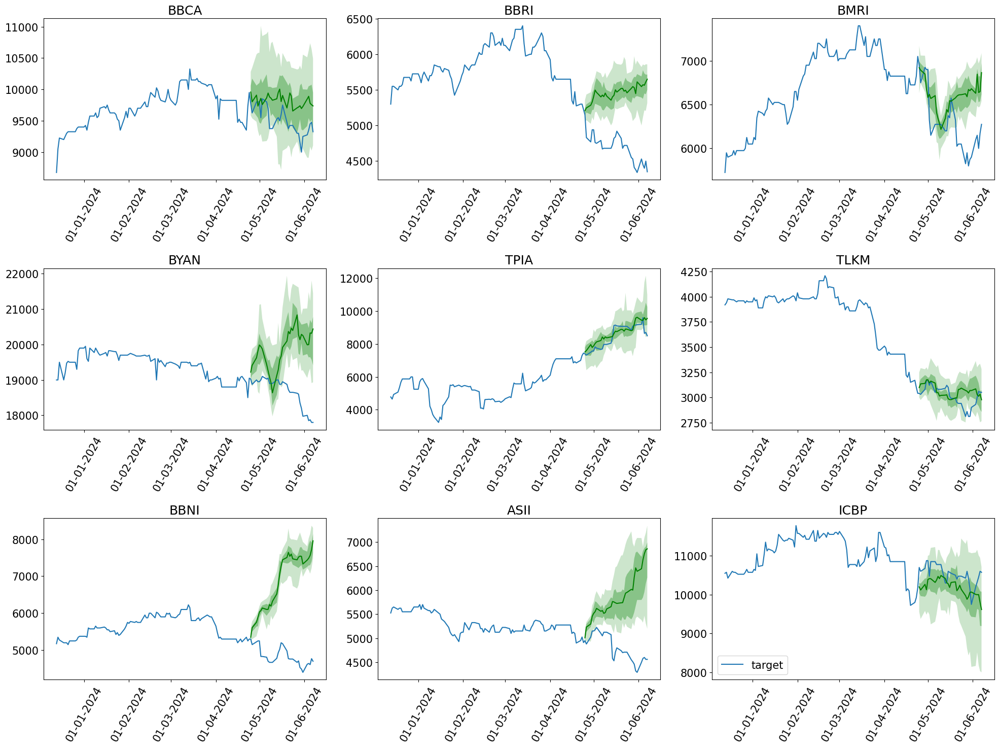

In [47]:
plotting(forecasts_fine_tuning_len_512_lr_1e_2, tss_fine_tuning_len_512_lr_1e_2)

### Get predictions with the default context length ***(1024)***

In [48]:
forecasts_fine_tuning_len_1024_lr_1e_2, tss_fine_tuning_len_1024_lr_1e_2, agg_metrics = lag_llama_fine_tuning(1024, 1e-2)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.97807 (best 9.97807), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_253\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.84794 (best 8.84794), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_253\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' was not in top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' reached 8.81338 (best 8.81338), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_253\\checkpoints\\epoch=6-step=350.ckpt' as top 1
Epoch 7, global step 400: 'train_loss' was not in top 1
Epoch 8, global step 450: 'train_loss' reached 8.71784 (best 8.71784), saving model to 'D:\\jupyter\\lag-llama-git\\lag

In [49]:
fine_tuning_len_1024_lr_1e_2 = print_crps_fine_tuning(1024, 1e-2, agg_metrics)

Lag-Llama Fine-Tuning (1024) Lr 0.01 CRPS: 0.0628


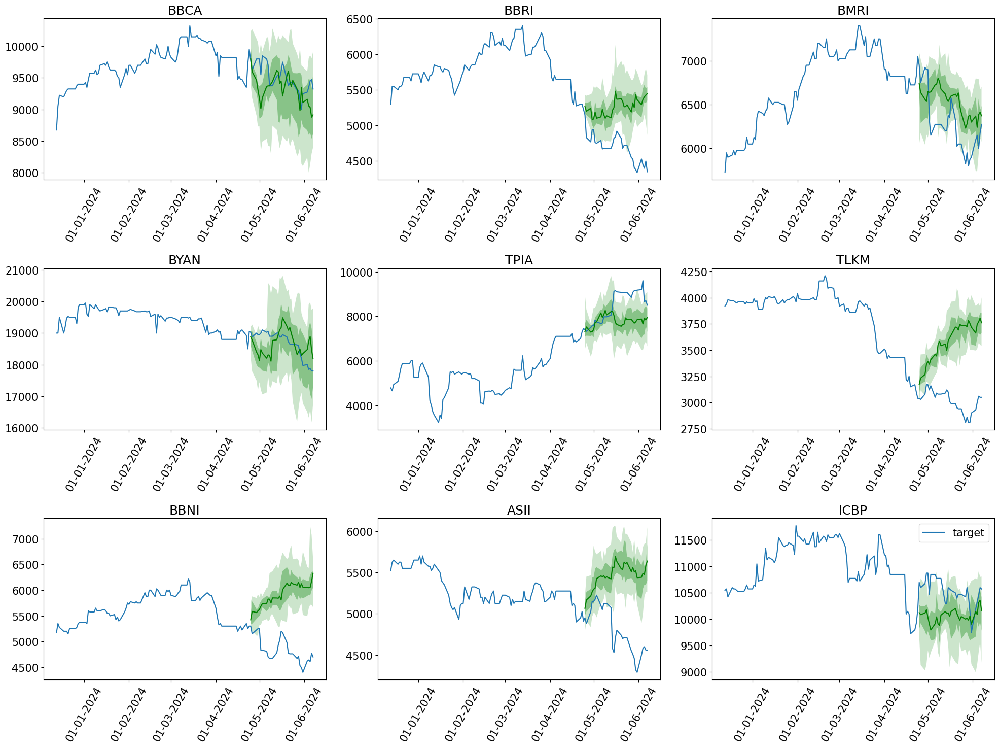

In [50]:
plotting(forecasts_fine_tuning_len_1024_lr_1e_2, tss_fine_tuning_len_1024_lr_1e_2)

### ***Learning Rate 1e-3***

### Get predictions with the default context length ***(32)***

In [51]:
forecasts_fine_tuning_len_32_lr_1e_3, tss_fine_tuning_len_32_lr_1e_3, agg_metrics = lag_llama_fine_tuning(32, 1e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.06757 (best 10.06757), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_254\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.95849 (best 8.95849), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_254\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.72186 (best 8.72186), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_254\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 8.16594 (best 8.16594), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_254\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' reached 7.93919 (best 7.93919), saving model 

In [52]:
fine_tuning_len_32_lr_1e_3 = print_crps_fine_tuning(32, 1e-3, agg_metrics)

Lag-Llama Fine-Tuning (32) Lr 0.001 CRPS: 0.2405


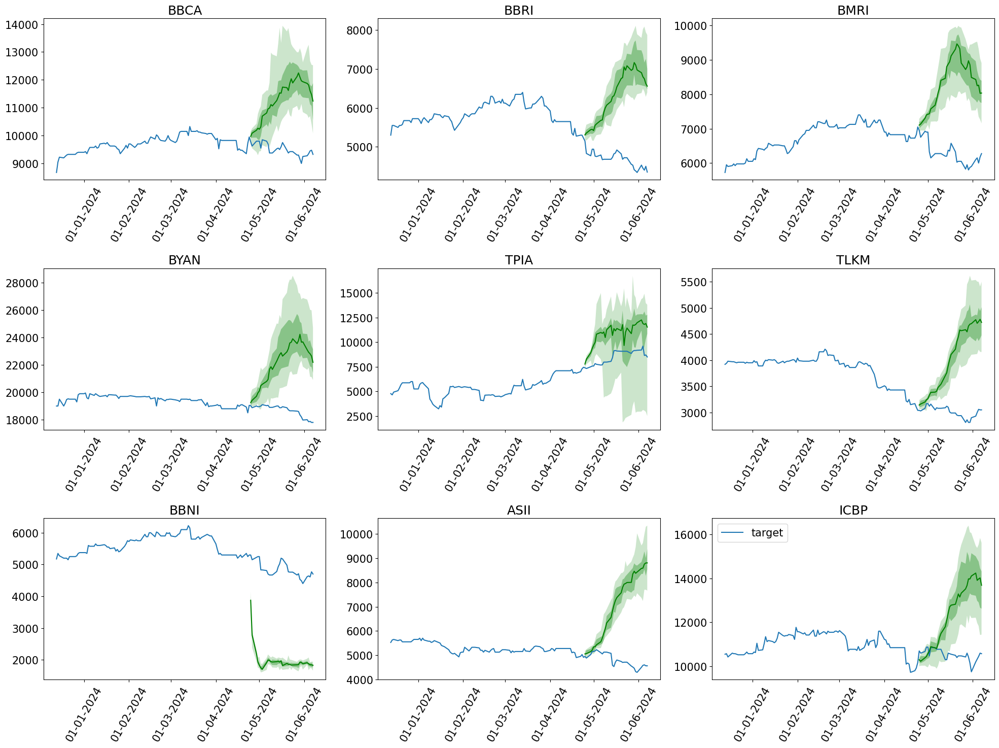

In [53]:
plotting(forecasts_fine_tuning_len_32_lr_1e_3, tss_fine_tuning_len_32_lr_1e_3)

### Get predictions with the default context length ***(64)***

In [54]:
forecasts_fine_tuning_len_64_lr_1e_3, tss_fine_tuning_len_64_lr_1e_3, agg_metrics = lag_llama_fine_tuning(64, 1e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.12698 (best 10.12698), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_255\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.84236 (best 8.84236), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_255\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.57450 (best 8.57450), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_255\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 8.05049 (best 8.05049), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_255\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 8.03332 (best 8.03332), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_255\\checkpoints\\epoch=4-step=250.ckpt' as t

In [55]:
fine_tuning_len_64_lr_1e_3 = print_crps_fine_tuning(64, 1e-3, agg_metrics)

Lag-Llama Fine-Tuning (64) Lr 0.001 CRPS: 0.1050


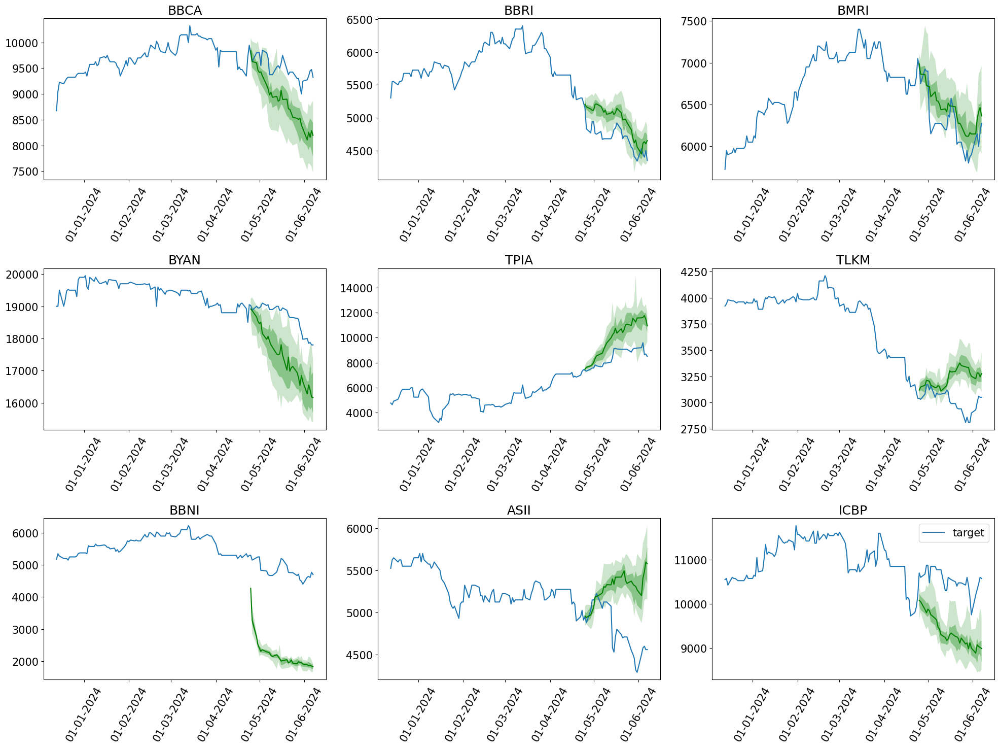

In [56]:
plotting(forecasts_fine_tuning_len_64_lr_1e_3, tss_fine_tuning_len_64_lr_1e_3)

### Get predictions with the default context length ***(128)***

In [57]:
forecasts_fine_tuning_len_128_lr_1e_3, tss_fine_tuning_len_128_lr_1e_3, agg_metrics = lag_llama_fine_tuning(128, 1e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.96414 (best 9.96414), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_256\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.77955 (best 8.77955), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_256\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.74951 (best 8.74951), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_256\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 8.38899 (best 8.38899), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_256\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' reached 7.64293 (best 7.64293), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [58]:
fine_tuning_len_128_lr_1e_3 = print_crps_fine_tuning(128, 1e-3, agg_metrics)

Lag-Llama Fine-Tuning (128) Lr 0.001 CRPS: 0.1050


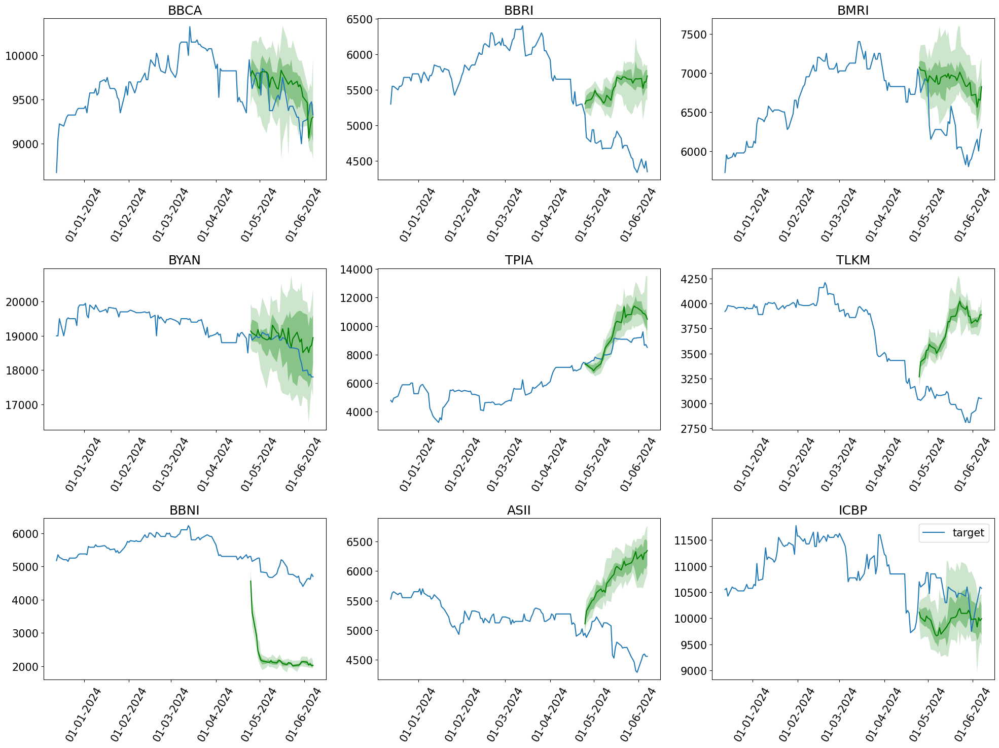

In [59]:
plotting(forecasts_fine_tuning_len_128_lr_1e_3, tss_fine_tuning_len_128_lr_1e_3)

### Get predictions with the default context length ***(256)***

In [60]:
forecasts_fine_tuning_len_256_lr_1e_3, tss_fine_tuning_len_256_lr_1e_3, agg_metrics = lag_llama_fine_tuning(256, 1e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 11.29806 (best 11.29806), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_257\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.75401 (best 8.75401), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_257\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.72440 (best 8.72440), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_257\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 8.04525 (best 8.04525), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_257\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 7.71912 (best 7.71912), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_257\\checkpoints\\epoch=4-step=250.ckpt' as t

In [61]:
fine_tuning_len_256_lr_1e_3 = print_crps_fine_tuning(256, 1e-3, agg_metrics)

Lag-Llama Fine-Tuning (256) Lr 0.001 CRPS: 0.0969


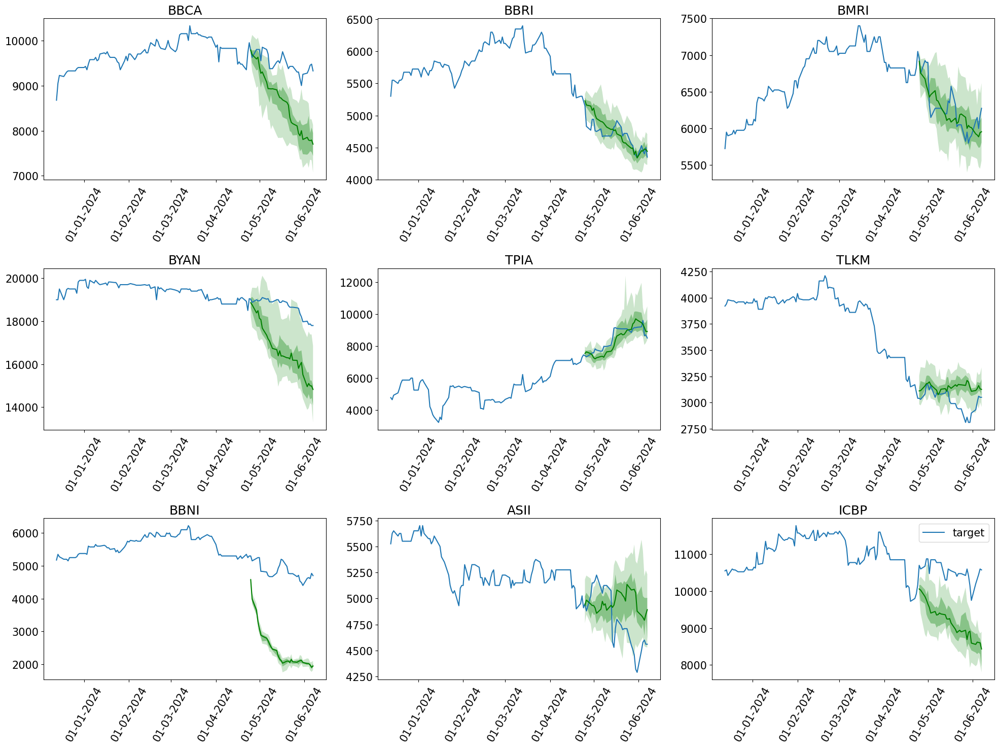

In [62]:
plotting(forecasts_fine_tuning_len_256_lr_1e_3, tss_fine_tuning_len_256_lr_1e_3)

### Get predictions with the default context length ***(512)***

In [63]:
forecasts_fine_tuning_len_512_lr_1e_3, tss_fine_tuning_len_512_lr_1e_3, agg_metrics = lag_llama_fine_tuning(512, 1e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.57354 (best 9.57354), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_258\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.34572 (best 8.34572), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_258\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.05186 (best 8.05186), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_258\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 7.69087 (best 7.69087), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_258\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' reached 7.30548 (best 7.30548), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [64]:
fine_tuning_len_512_lr_1e_3 = print_crps_fine_tuning(512, 1e-3, agg_metrics)

Lag-Llama Fine-Tuning (512) Lr 0.001 CRPS: 0.1151


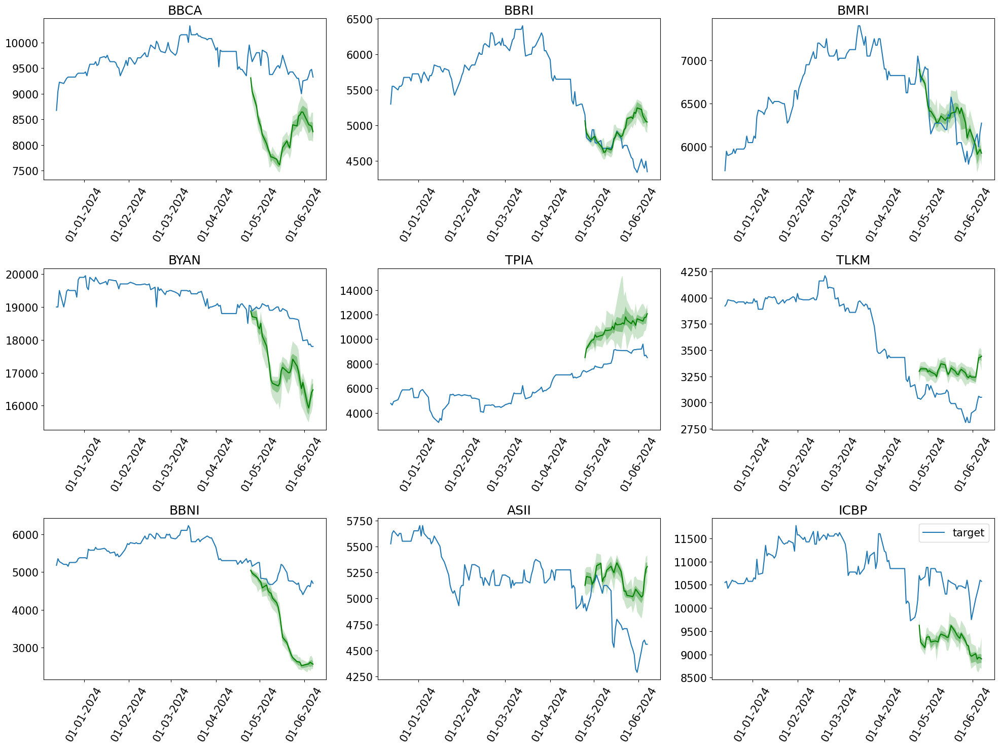

In [65]:
plotting(forecasts_fine_tuning_len_512_lr_1e_3, tss_fine_tuning_len_512_lr_1e_3)

### Get predictions with the default context length ***(1024)***

In [66]:
forecasts_fine_tuning_len_1024_lr_1e_3, tss_fine_tuning_len_1024_lr_1e_3, agg_metrics = lag_llama_fine_tuning(1024, 1e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.42272 (best 9.42272), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_259\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.66611 (best 8.66611), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_259\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.10291 (best 8.10291), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_259\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 7.70105 (best 7.70105), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_259\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' was not in top 1
Epoch 7, global step 400: 'tra

In [67]:
fine_tuning_len_1024_lr_1e_3 = print_crps_fine_tuning(1024, 1e-3, agg_metrics)

Lag-Llama Fine-Tuning (1024) Lr 0.001 CRPS: 0.0949


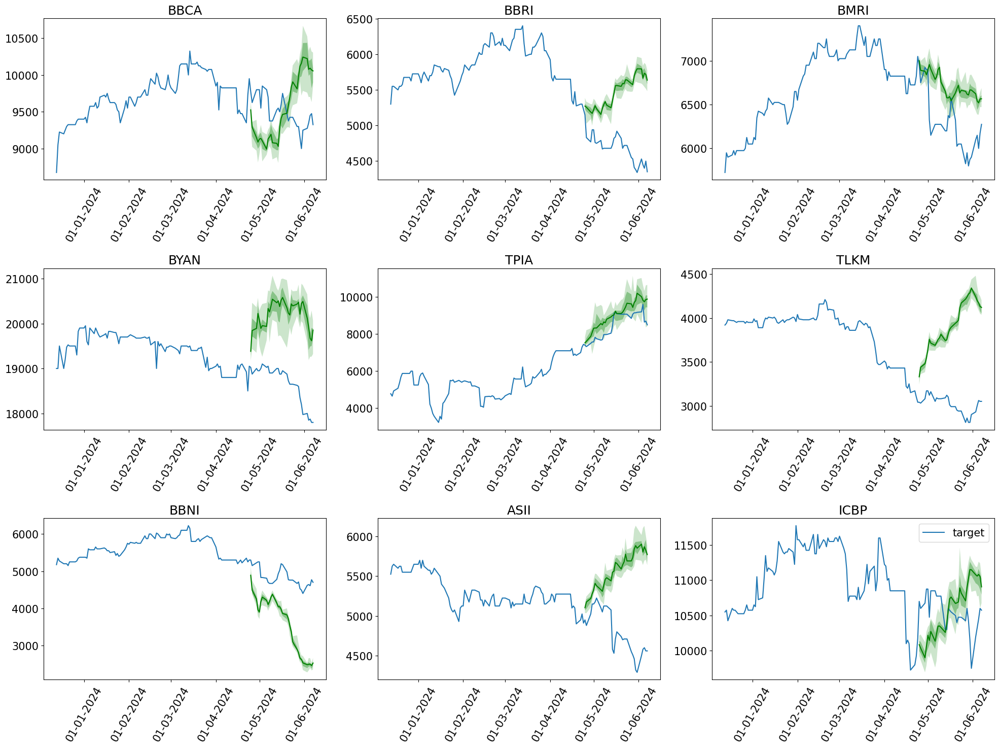

In [68]:
plotting(forecasts_fine_tuning_len_1024_lr_1e_3, tss_fine_tuning_len_1024_lr_1e_3)

### ***Learning Rate 1e-4***

### Get predictions with the default context length ***(32)***

In [69]:
forecasts_fine_tuning_len_32_lr_1e_4, tss_fine_tuning_len_32_lr_1e_4, agg_metrics = lag_llama_fine_tuning(32, 1e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 7.51995 (best 7.51995), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_260\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.56261 (best 6.56261), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_260\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.50808 (best 6.50808), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_260\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 6.48154 (best 6.48154), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_260\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 6.45284 (best 6.45284), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [70]:
fine_tuning_len_32_lr_1e_4 = print_crps_fine_tuning(32, 1e-4, agg_metrics)

Lag-Llama Fine-Tuning (32) Lr 0.0001 CRPS: 0.0913


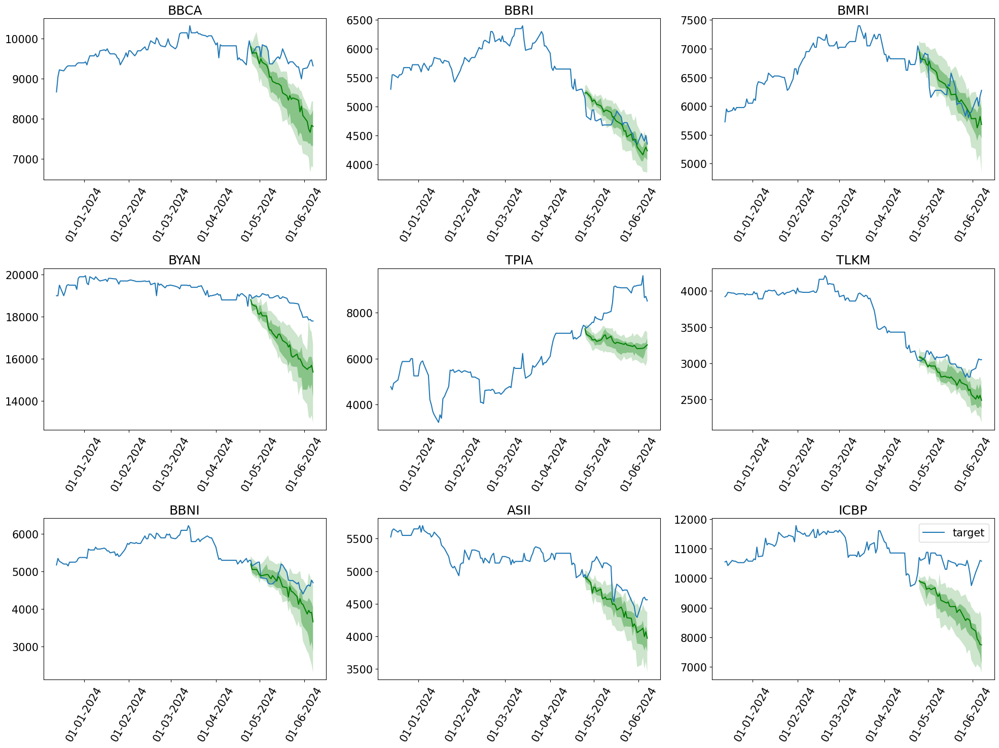

In [71]:
plotting(forecasts_fine_tuning_len_32_lr_1e_4, tss_fine_tuning_len_32_lr_1e_4)

### Get predictions with the default context length ***(64)***

In [72]:
forecasts_fine_tuning_len_64_lr_1e_4, tss_fine_tuning_len_64_lr_1e_4, agg_metrics = lag_llama_fine_tuning(64, 1e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 7.47860 (best 7.47860), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_261\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.58574 (best 6.58574), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_261\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.49980 (best 6.49980), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_261\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 6.48594 (best 6.48594), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_261\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 6.45674 (best 6.45674), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [73]:
fine_tuning_len_64_lr_1e_4 = print_crps_fine_tuning(64, 1e-4, agg_metrics)

Lag-Llama Fine-Tuning (64) Lr 0.0001 CRPS: 0.1167


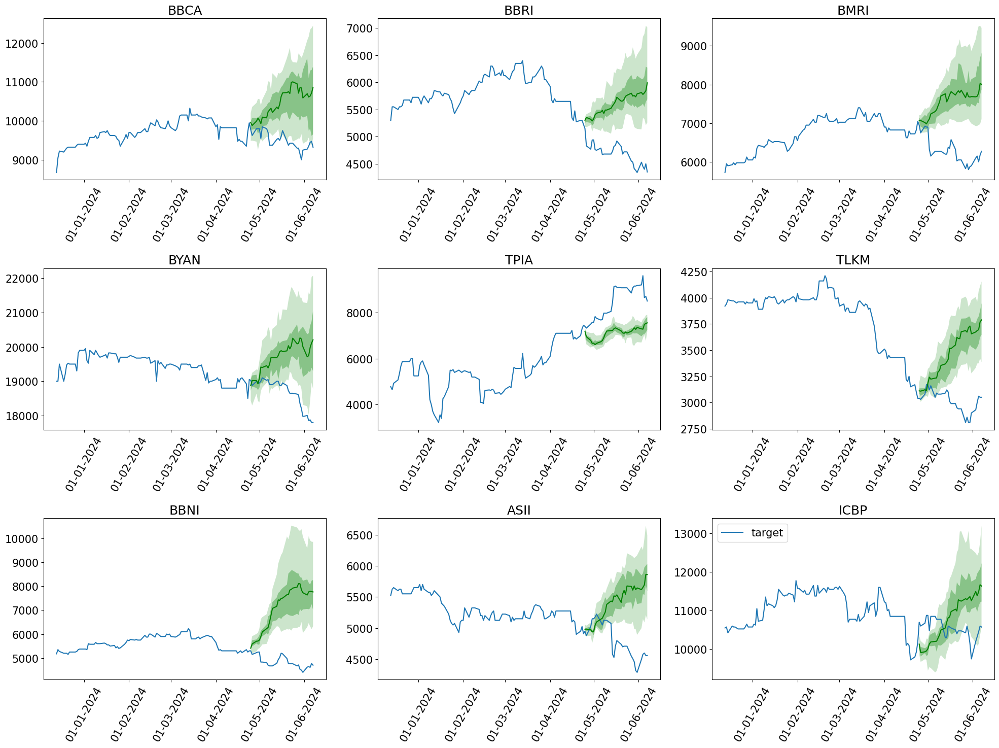

In [74]:
plotting(forecasts_fine_tuning_len_64_lr_1e_4, tss_fine_tuning_len_64_lr_1e_4)

### Get predictions with the default context length ***(128)***

In [75]:
forecasts_fine_tuning_len_128_lr_1e_4, tss_fine_tuning_len_128_lr_1e_4, agg_metrics = lag_llama_fine_tuning(128, 1e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 7.45911 (best 7.45911), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_262\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.60642 (best 6.60642), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_262\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.51449 (best 6.51449), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_262\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.49683 (best 6.49683), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_262\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' reached 6.47213 (best 6.47213), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [76]:
fine_tuning_len_128_lr_1e_4 = print_crps_fine_tuning(128, 1e-4, agg_metrics)

Lag-Llama Fine-Tuning (128) Lr 0.0001 CRPS: 0.0686


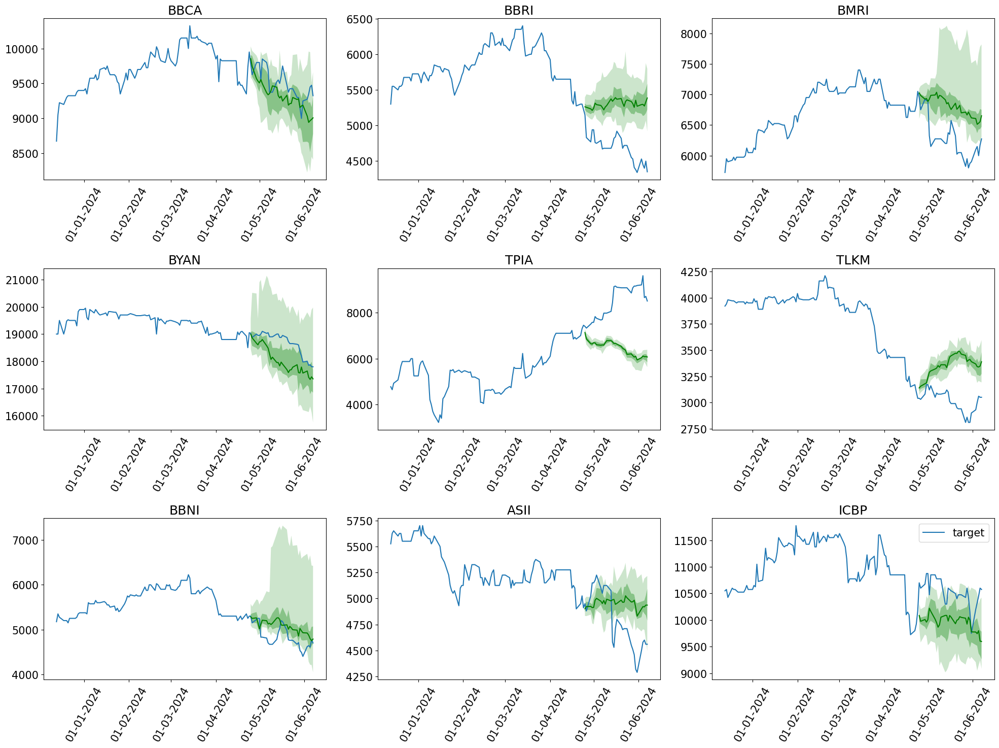

In [77]:
plotting(forecasts_fine_tuning_len_128_lr_1e_4, tss_fine_tuning_len_128_lr_1e_4)

### Get predictions with the default context length ***(256)***

In [78]:
forecasts_fine_tuning_len_256_lr_1e_4, tss_fine_tuning_len_256_lr_1e_4, agg_metrics = lag_llama_fine_tuning(256, 1e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 7.53305 (best 7.53305), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_263\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.61059 (best 6.61059), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_263\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.55927 (best 6.55927), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_263\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.51945 (best 6.51945), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_263\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 6.49745 (best 6.49745), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_263\\checkpoints\\epoch=4-step=250.ckpt' as top

In [79]:
fine_tuning_len_256_lr_1e_4 = print_crps_fine_tuning(256, 1e-4, agg_metrics)

Lag-Llama Fine-Tuning (256) Lr 0.0001 CRPS: 0.0594


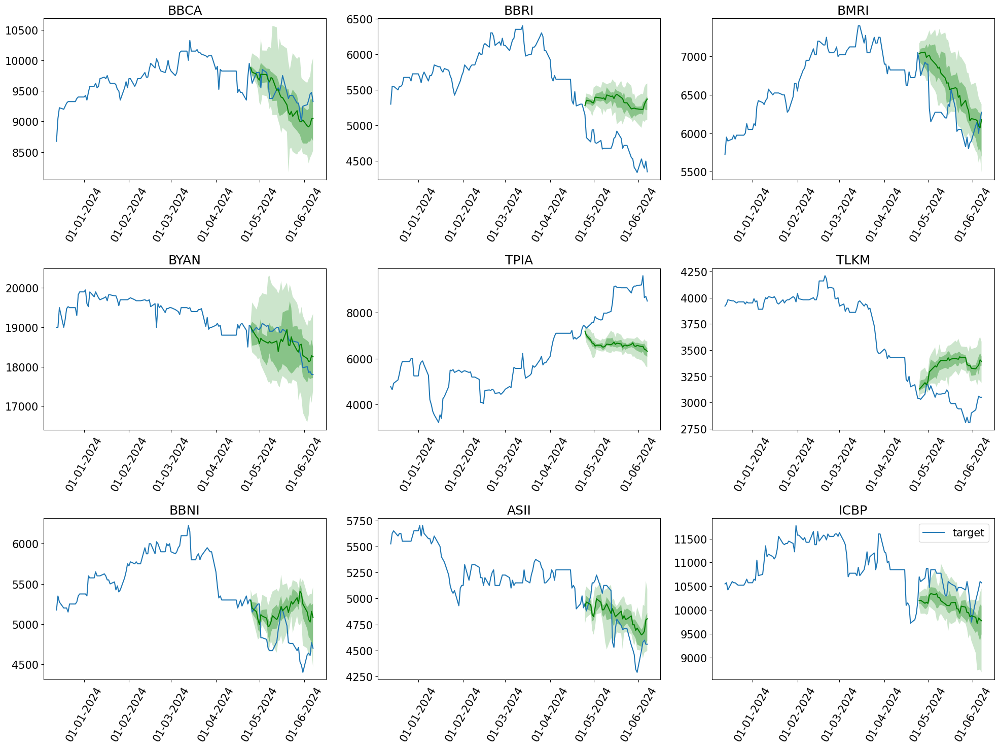

In [80]:
plotting(forecasts_fine_tuning_len_256_lr_1e_4, tss_fine_tuning_len_256_lr_1e_4)

### Get predictions with the default context length ***(512)***

In [81]:
forecasts_fine_tuning_len_512_lr_1e_4, tss_fine_tuning_len_512_lr_1e_4, agg_metrics = lag_llama_fine_tuning(512, 1e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 7.16201 (best 7.16201), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_264\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.58893 (best 6.58893), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_264\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.55537 (best 6.55537), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_264\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.50197 (best 6.50197), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_264\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' reached 6.50087 (best 6.50087), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [82]:
fine_tuning_len_512_lr_1e_4 = print_crps_fine_tuning(512, 1e-4, agg_metrics)

Lag-Llama Fine-Tuning (512) Lr 0.0001 CRPS: 0.0750


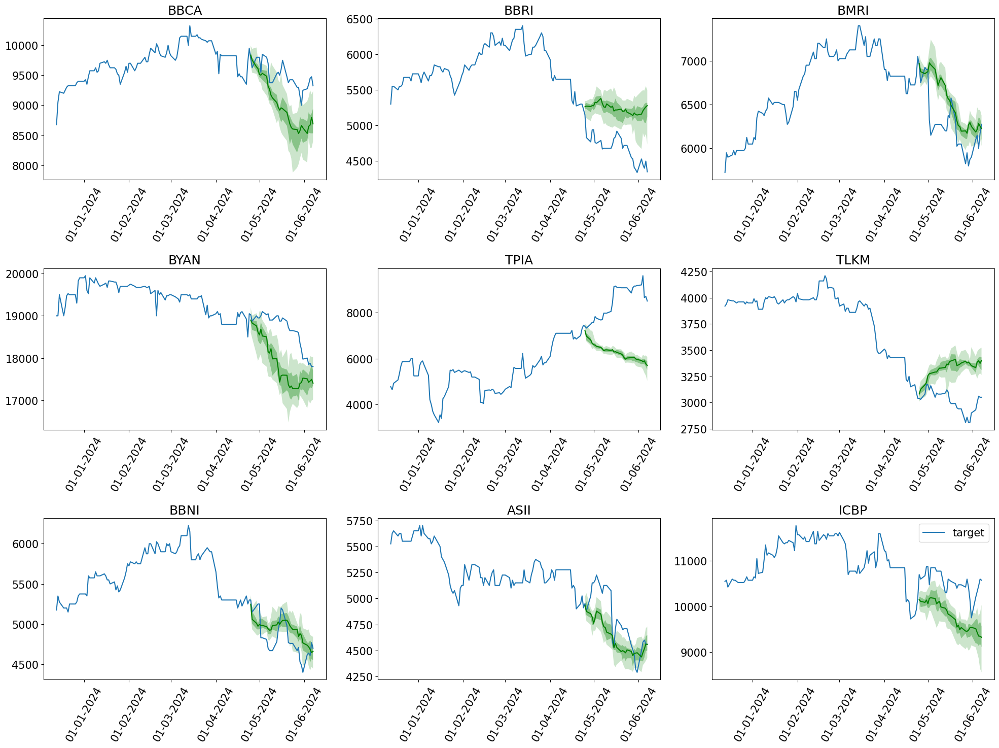

In [83]:
plotting(forecasts_fine_tuning_len_512_lr_1e_4, tss_fine_tuning_len_512_lr_1e_4)

### Get predictions with the default context length ***(1024)***

In [84]:
forecasts_fine_tuning_len_1024_lr_1e_4, tss_fine_tuning_len_1024_lr_1e_4, agg_metrics = lag_llama_fine_tuning(1024, 1e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 7.16938 (best 7.16938), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_265\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.65931 (best 6.65931), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_265\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.63535 (best 6.63535), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_265\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.57561 (best 6.57561), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_265\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 6.55836 (best 6.55836), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_265\\checkpoints\\epoch=4-step=250.ckpt' as top

In [85]:
fine_tuning_len_1024_lr_1e_4 = print_crps_fine_tuning(1024, 1e-4, agg_metrics)

Lag-Llama Fine-Tuning (1024) Lr 0.0001 CRPS: 0.1075


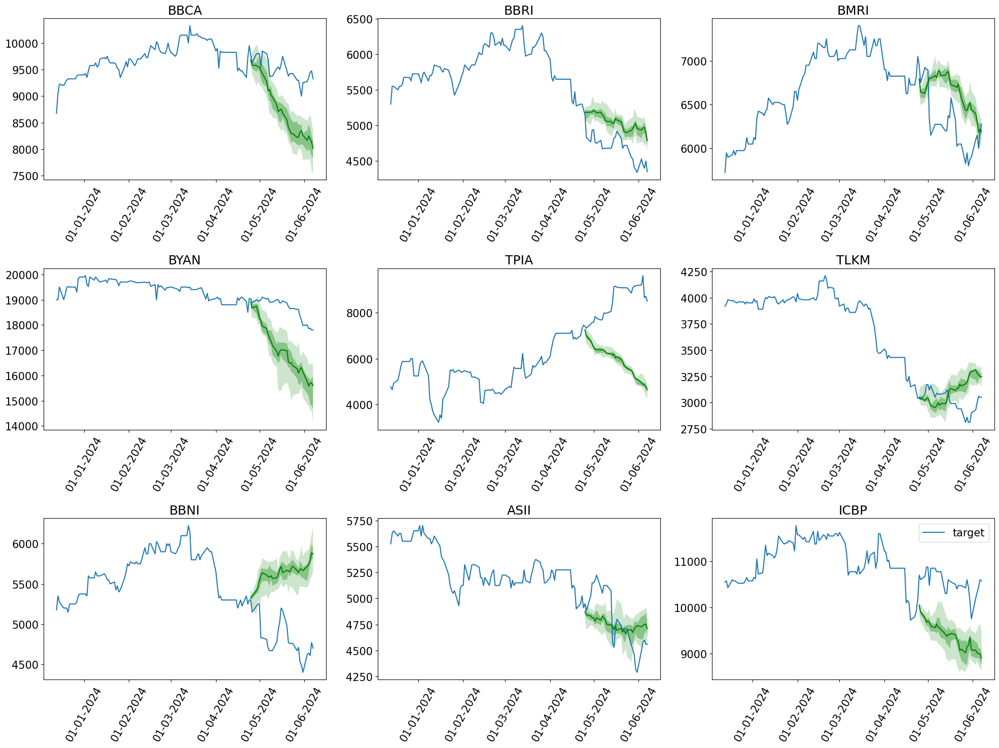

In [86]:
plotting(forecasts_fine_tuning_len_1024_lr_1e_4, tss_fine_tuning_len_1024_lr_1e_4)

### ***Learning Rate 5e-3***

### Get predictions with the default context length ***(32)***

In [87]:
forecasts_fine_tuning_len_32_lr_5e_3, tss_fine_tuning_len_32_lr_5e_3, agg_metrics = lag_llama_fine_tuning(32, 5e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.12123 (best 10.12123), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_266\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 9.01818 (best 9.01818), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_266\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.94155 (best 8.94155), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_266\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 8.90650 (best 8.90650), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_266\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' reached 8.42677 (best 8.42677), saving model 

In [88]:
fine_tuning_len_32_lr_5e_3 = print_crps_fine_tuning(32, 5e-3, agg_metrics)

Lag-Llama Fine-Tuning (32) Lr 0.005 CRPS: 0.2543


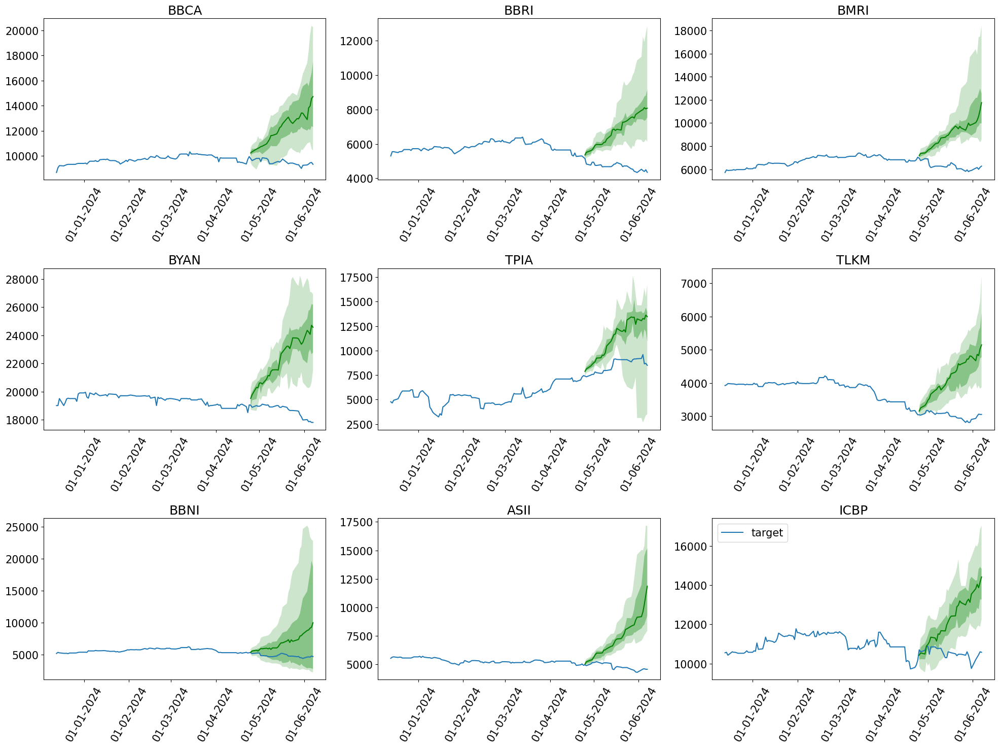

In [89]:
plotting(forecasts_fine_tuning_len_32_lr_5e_3, tss_fine_tuning_len_32_lr_5e_3)

### Get predictions with the default context length ***(64)***

In [90]:
forecasts_fine_tuning_len_64_lr_5e_3, tss_fine_tuning_len_64_lr_5e_3, agg_metrics = lag_llama_fine_tuning(64, 5e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.13646 (best 10.13646), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_267\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 9.05905 (best 9.05905), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_267\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 9.01222 (best 9.01222), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_267\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 8.92516 (best 8.92516), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_267\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 8.81838 (best 8.81838), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_log

In [91]:
fine_tuning_len_64_lr_5e_3 = print_crps_fine_tuning(64, 5e-3, agg_metrics)

Lag-Llama Fine-Tuning (64) Lr 0.005 CRPS: 0.4983


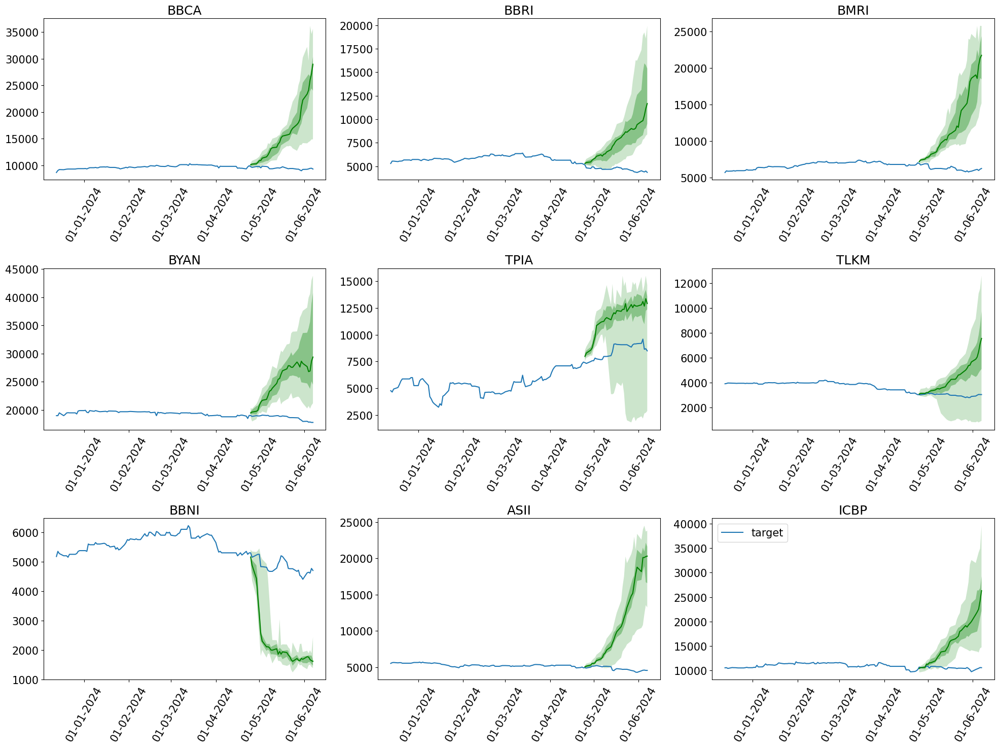

In [92]:
plotting(forecasts_fine_tuning_len_64_lr_5e_3, tss_fine_tuning_len_64_lr_5e_3)

### Get predictions with the default context length ***(128)***

In [93]:
forecasts_fine_tuning_len_128_lr_5e_3, tss_fine_tuning_len_128_lr_5e_3, agg_metrics = lag_llama_fine_tuning(128, 5e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.44927 (best 10.44927), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_268\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.91762 (best 8.91762), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_268\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' was not in top 1
Epoch 3, global step 200: 'train_loss' reached 8.81731 (best 8.81731), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_268\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 8.69544 (best 8.69544), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_268\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 8.62660 (best 8.62660), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_log

In [94]:
fine_tuning_len_128_lr_5e_3 = print_crps_fine_tuning(128, 5e-3, agg_metrics)

Lag-Llama Fine-Tuning (128) Lr 0.005 CRPS: 0.4926


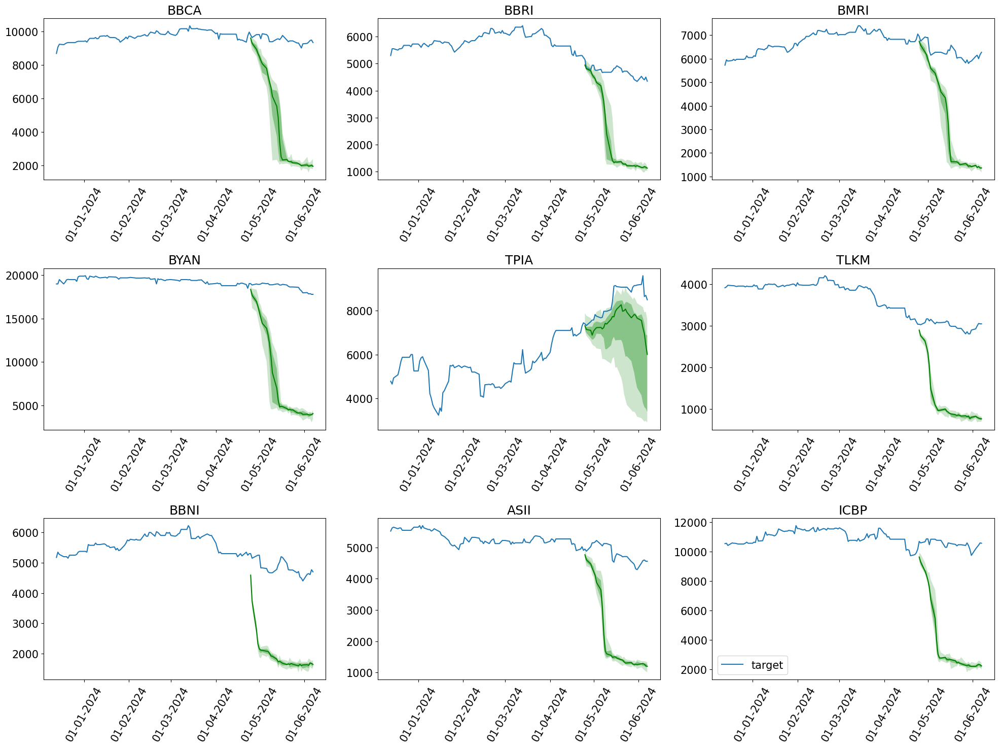

In [95]:
plotting(forecasts_fine_tuning_len_128_lr_5e_3, tss_fine_tuning_len_128_lr_5e_3)

### Get predictions with the default context length ***(256)***

In [96]:
forecasts_fine_tuning_len_256_lr_5e_3, tss_fine_tuning_len_256_lr_5e_3, agg_metrics = lag_llama_fine_tuning(256, 5e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.05363 (best 10.05363), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_269\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.83416 (best 8.83416), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_269\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.81291 (best 8.81291), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_269\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 8.73128 (best 8.73128), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_269\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 8.70582 (best 8.70582), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_269\\checkpoints\\epoch=4-step=250.ckpt' as t

In [97]:
fine_tuning_len_256_lr_5e_3 = print_crps_fine_tuning(256, 5e-3, agg_metrics)

Lag-Llama Fine-Tuning (256) Lr 0.005 CRPS: 0.1087


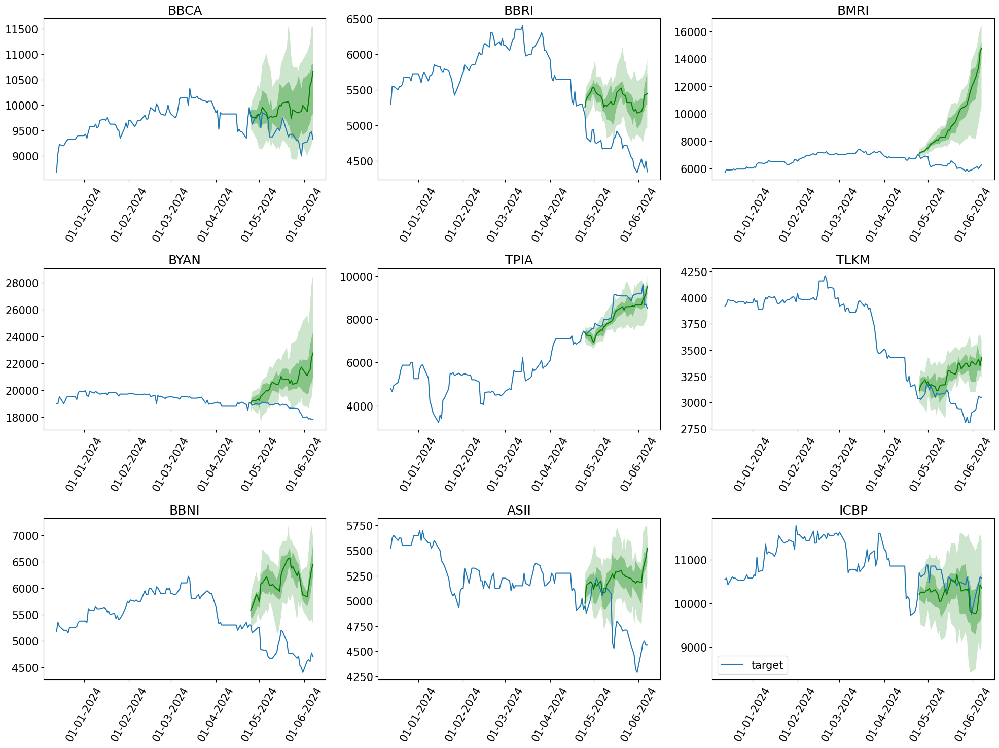

In [98]:
plotting(forecasts_fine_tuning_len_256_lr_5e_3, tss_fine_tuning_len_256_lr_5e_3)

### Get predictions with the default context length ***(512)***

In [99]:
forecasts_fine_tuning_len_512_lr_5e_3, tss_fine_tuning_len_512_lr_5e_3, agg_metrics = lag_llama_fine_tuning(512, 5e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 10.28146 (best 10.28146), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_270\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.81174 (best 8.81174), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_270\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' was not in top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 8.48918 (best 8.48918), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_270\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 8.37860 (best 8.37860), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_270\\checkpoints\\epoch=5-step=300.ckpt' as top 1
Epoch 6, global step 350: 'train_loss' reached 8.24396 (best 8.24396), saving model 

In [100]:
fine_tuning_len_512_lr_5e_3 = print_crps_fine_tuning(512, 5e-3, agg_metrics)

Lag-Llama Fine-Tuning (512) Lr 0.005 CRPS: 0.0977


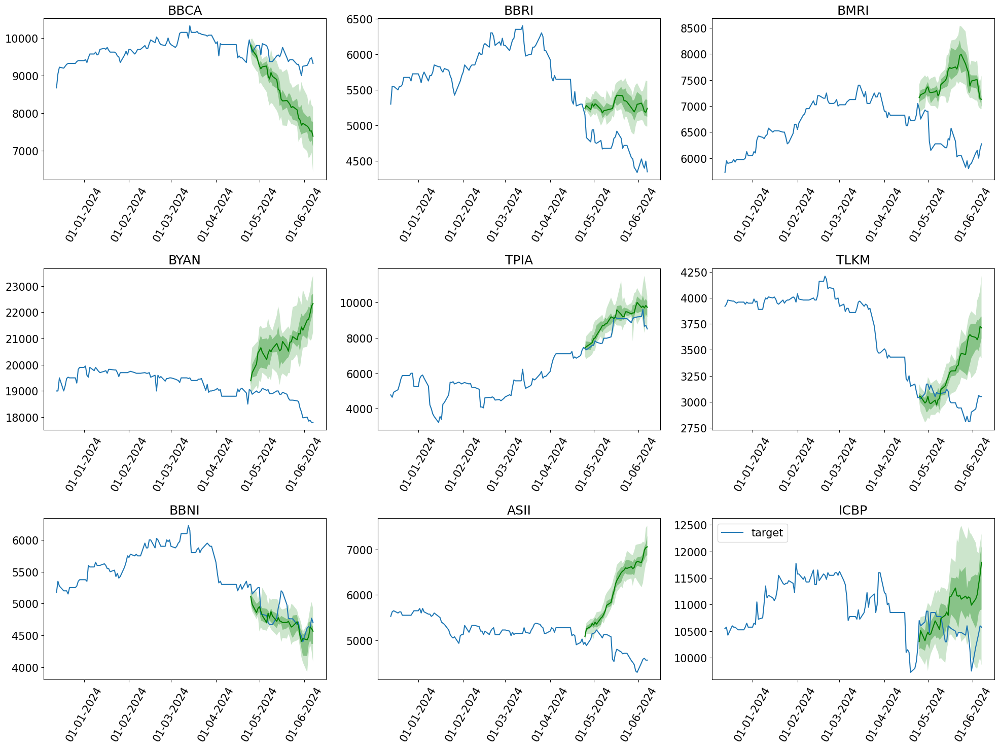

In [101]:
plotting(forecasts_fine_tuning_len_512_lr_5e_3, tss_fine_tuning_len_512_lr_5e_3)

### Get predictions with the default context length ***(1024)***

In [102]:
forecasts_fine_tuning_len_1024_lr_5e_3, tss_fine_tuning_len_1024_lr_5e_3, agg_metrics = lag_llama_fine_tuning(1024, 5e-3)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.63340 (best 9.63340), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_271\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.79212 (best 8.79212), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_271\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' was not in top 1
Epoch 3, global step 200: 'train_loss' reached 8.69940 (best 8.69940), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_271\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' reached 8.66775 (best 8.66775), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_271\\checkpoints\\epoch=5-step=300.ckpt' as top 1
Epoch 6, global step 350: 'train_loss' reached 8.34865 (best 8.34865), saving model to

In [103]:
fine_tuning_len_1024_lr_5e_3 = print_crps_fine_tuning(1024, 5e-3, agg_metrics)

Lag-Llama Fine-Tuning (1024) Lr 0.005 CRPS: 0.1544


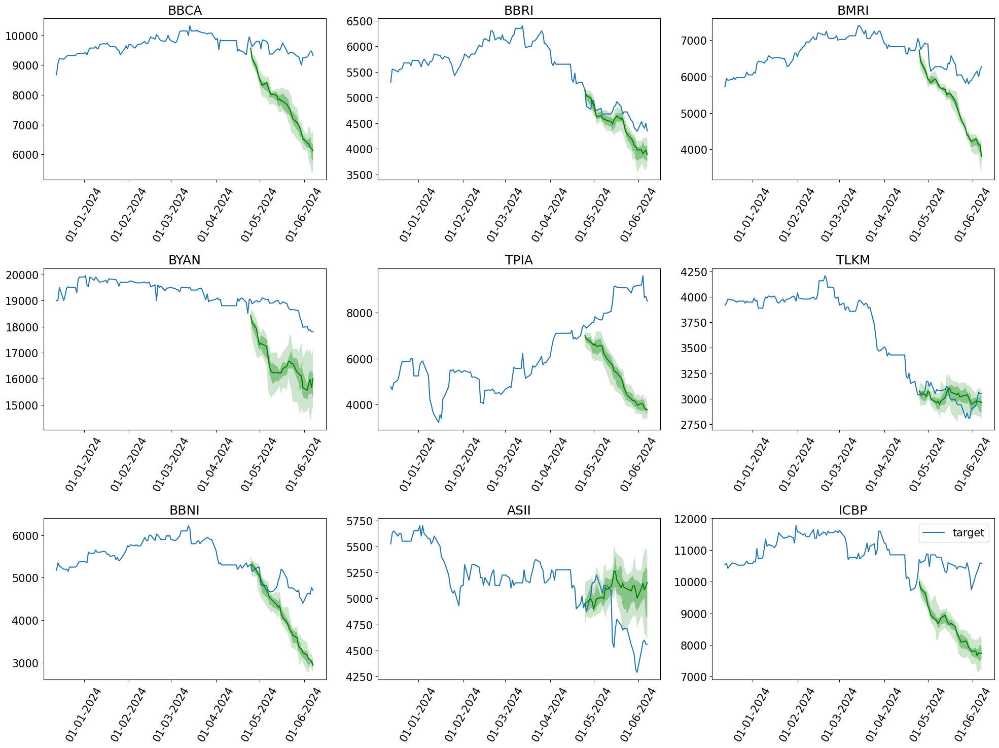

In [104]:
plotting(forecasts_fine_tuning_len_1024_lr_5e_3, tss_fine_tuning_len_1024_lr_5e_3)

### ***Learning Rate 5e-4***

### Get predictions with the default context length ***(32)***

In [105]:
forecasts_fine_tuning_len_32_lr_5e_4, tss_fine_tuning_len_32_lr_5e_4, agg_metrics = lag_llama_fine_tuning(32, 5e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.40898 (best 9.40898), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_272\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.14625 (best 8.14625), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_272\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 7.91970 (best 7.91970), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_272\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 7.84625 (best 7.84625), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_272\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 7.62866 (best 7.62866), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [106]:
fine_tuning_len_32_lr_5e_4 = print_crps_fine_tuning(32, 5e-4, agg_metrics)

Lag-Llama Fine-Tuning (32) Lr 0.0005 CRPS: 0.2317


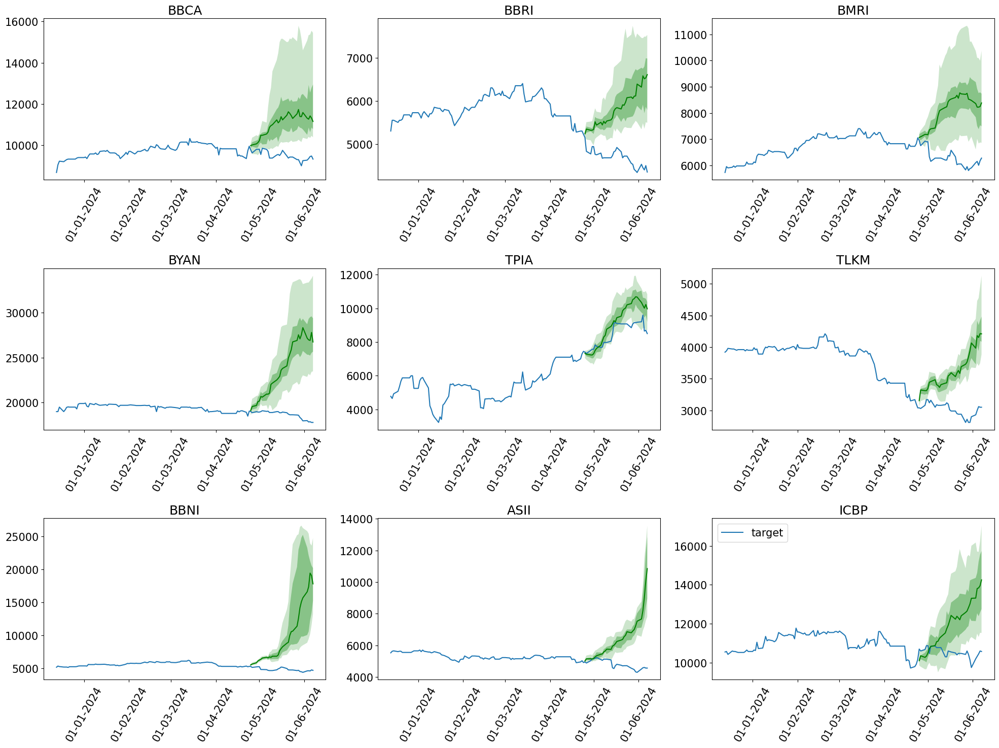

In [107]:
plotting(forecasts_fine_tuning_len_32_lr_5e_4, tss_fine_tuning_len_32_lr_5e_4)

### Get predictions with the default context length ***(64)***

In [108]:
forecasts_fine_tuning_len_64_lr_5e_4, tss_fine_tuning_len_64_lr_5e_4, agg_metrics = lag_llama_fine_tuning(64, 5e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.38049 (best 9.38049), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_273\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.18357 (best 8.18357), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_273\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.14641 (best 8.14641), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_273\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 7.50069 (best 7.50069), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_273\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 7.16637 (best 7.16637), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_273\\checkpoints\\epoch=4-step=250.ckpt' as top

In [109]:
fine_tuning_len_64_lr_5e_4 = print_crps_fine_tuning(64, 5e-4, agg_metrics)

Lag-Llama Fine-Tuning (64) Lr 0.0005 CRPS: 0.0725


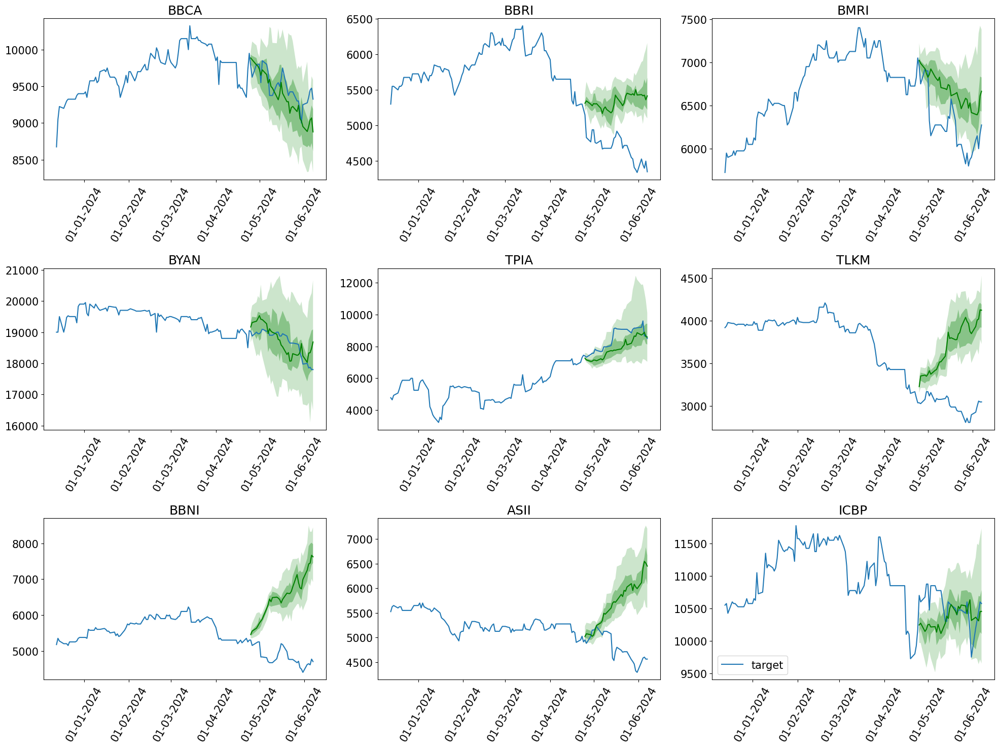

In [110]:
plotting(forecasts_fine_tuning_len_64_lr_5e_4, tss_fine_tuning_len_64_lr_5e_4)

### Get predictions with the default context length ***(128)***

In [111]:
forecasts_fine_tuning_len_128_lr_5e_4, tss_fine_tuning_len_128_lr_5e_4, agg_metrics = lag_llama_fine_tuning(128, 5e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.46711 (best 9.46711), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_274\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8.24634 (best 8.24634), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_274\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 8.01860 (best 8.01860), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_274\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 7.48498 (best 7.48498), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_274\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 7.15676 (best 7.15676), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_274\\checkpoints\\epoch=4-step=250.ckpt' as top

In [112]:
fine_tuning_len_128_lr_5e_4 = print_crps_fine_tuning(128, 5e-4, agg_metrics)

Lag-Llama Fine-Tuning (128) Lr 0.0005 CRPS: 0.1360


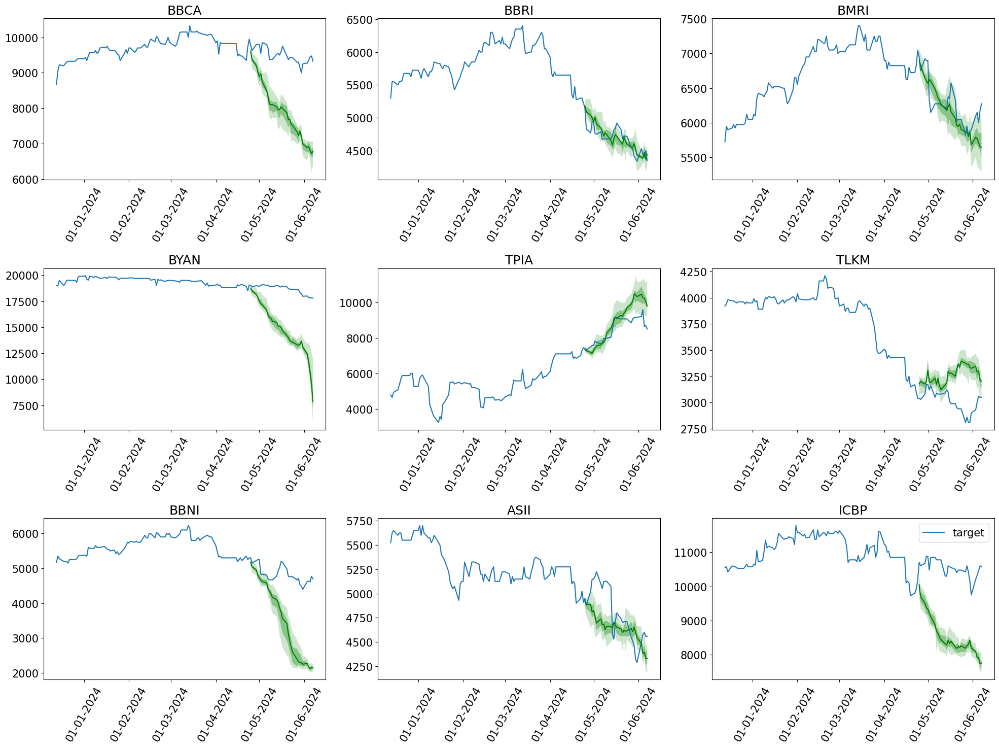

In [113]:
plotting(forecasts_fine_tuning_len_128_lr_5e_4, tss_fine_tuning_len_128_lr_5e_4)

### Get predictions with the default context length ***(256)***

In [114]:
forecasts_fine_tuning_len_256_lr_5e_4, tss_fine_tuning_len_256_lr_5e_4, agg_metrics = lag_llama_fine_tuning(256, 5e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 8.90842 (best 8.90842), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_275\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 7.54616 (best 7.54616), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_275\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' was not in top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 7.02646 (best 7.02646), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_275\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 6.99845 (best 6.99845), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_275\\checkpoints\\epoch=5-step=300.ckpt' as top 1
Epoch 6, global step 350: 'train_loss' was not in top 1
Epoch 7, global step 400: 'tra

In [115]:
fine_tuning_len_256_lr_5e_4 = print_crps_fine_tuning(256, 5e-4, agg_metrics)

Lag-Llama Fine-Tuning (256) Lr 0.0005 CRPS: 0.0944


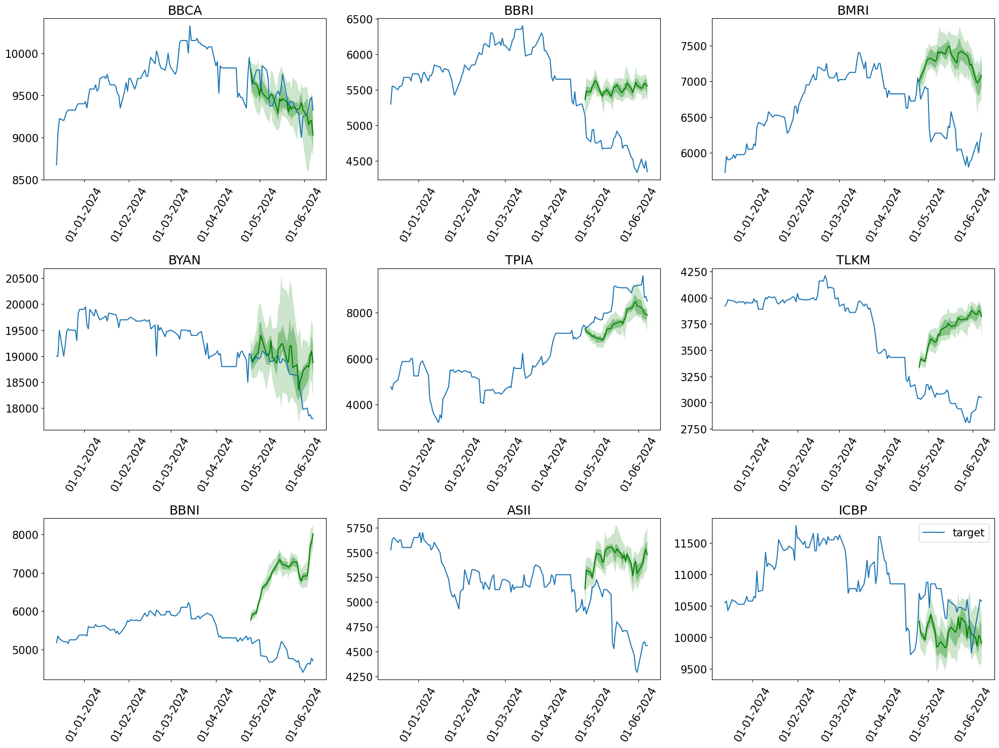

In [116]:
plotting(forecasts_fine_tuning_len_256_lr_5e_4, tss_fine_tuning_len_256_lr_5e_4)

### Get predictions with the default context length ***(512)***

In [117]:
forecasts_fine_tuning_len_512_lr_5e_4, tss_fine_tuning_len_512_lr_5e_4, agg_metrics = lag_llama_fine_tuning(512, 5e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9.42734 (best 9.42734), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_276\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 7.88078 (best 7.88078), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_276\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 7.36674 (best 7.36674), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_276\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' reached 7.18391 (best 7.18391), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_276\\checkpoints\\epoch=6-step=350.ckpt' as top 1
Epoch 7, global step 400: 'tra

In [118]:
fine_tuning_len_512_lr_5e_4 = print_crps_fine_tuning(512, 5e-4, agg_metrics)

Lag-Llama Fine-Tuning (512) Lr 0.0005 CRPS: 0.1198


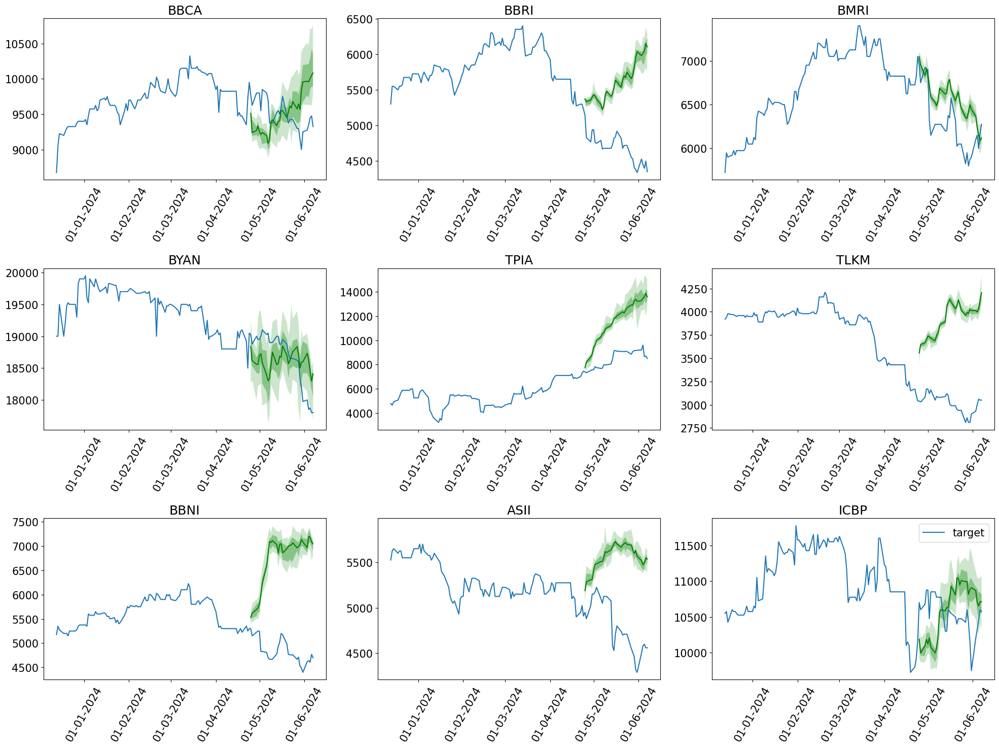

In [119]:
plotting(forecasts_fine_tuning_len_512_lr_5e_4, tss_fine_tuning_len_512_lr_5e_4)

### Get predictions with the default context length ***(1024)***

In [120]:
forecasts_fine_tuning_len_1024_lr_5e_4, tss_fine_tuning_len_1024_lr_5e_4, agg_metrics = lag_llama_fine_tuning(1024, 5e-4)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 8.46051 (best 8.46051), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_277\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' was not in top 1
Epoch 2, global step 150: 'train_loss' reached 7.97139 (best 7.97139), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_277\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 7.75823 (best 7.75823), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_277\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 7.70521 (best 7.70521), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_277\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 7.02585 (best 7.02585), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [121]:
fine_tuning_len_1024_lr_5e_4 = print_crps_fine_tuning(1024, 5e-4, agg_metrics)

Lag-Llama Fine-Tuning (1024) Lr 0.0005 CRPS: 0.0838


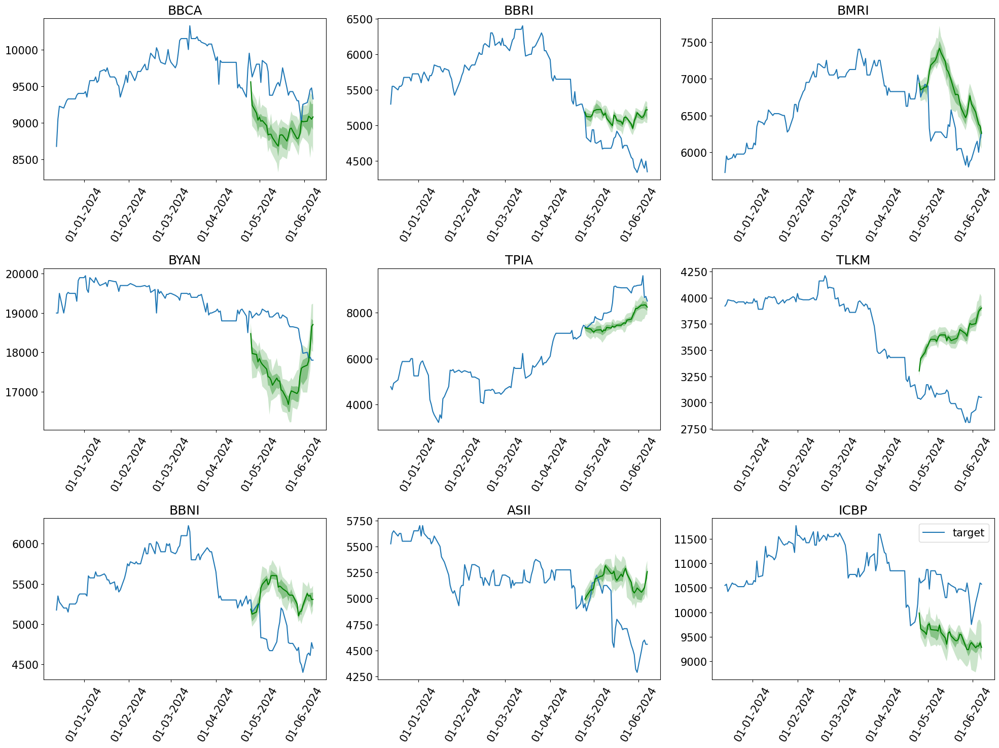

In [122]:
plotting(forecasts_fine_tuning_len_1024_lr_5e_4, tss_fine_tuning_len_1024_lr_5e_4)

### ***Learning Rate 5e-5***

### Get predictions with the default context length ***(32)***

In [123]:
forecasts_fine_tuning_len_32_lr_5e_5, tss_fine_tuning_len_32_lr_5e_5, agg_metrics = lag_llama_fine_tuning(32, 5e-5)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 6.85561 (best 6.85561), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_278\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.45859 (best 6.45859), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_278\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.43974 (best 6.43974), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_278\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.43770 (best 6.43770), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_278\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 6.43528 (best 6.43528), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_278\\checkpoints\\epoch=4-step=250.ckpt' as top

In [124]:
fine_tuning_len_32_lr_5e_5 = print_crps_fine_tuning(32, 5e-5, agg_metrics)

Lag-Llama Fine-Tuning (32) Lr 5e-05 CRPS: 0.0771


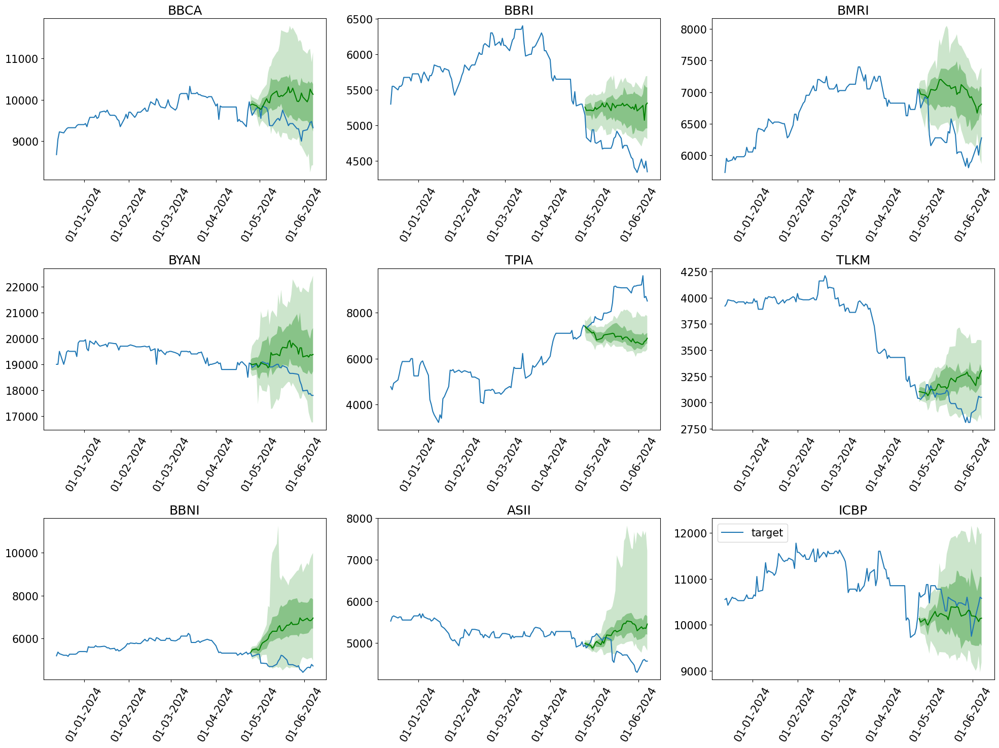

In [125]:
plotting(forecasts_fine_tuning_len_32_lr_5e_5, tss_fine_tuning_len_32_lr_5e_5)

### Get predictions with the default context length ***(64)***

In [126]:
forecasts_fine_tuning_len_64_lr_5e_5, tss_fine_tuning_len_64_lr_5e_5, agg_metrics = lag_llama_fine_tuning(64, 5e-5)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 6.84744 (best 6.84744), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_279\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.50147 (best 6.50147), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_279\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.47882 (best 6.47882), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_279\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.44490 (best 6.44490), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_279\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 6.42792 (best 6.42792), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_279\\checkpoints\\epoch=4-step=250.ckpt' as top

In [127]:
fine_tuning_len_64_lr_5e_5 = print_crps_fine_tuning(64, 5e-5, agg_metrics)

Lag-Llama Fine-Tuning (64) Lr 5e-05 CRPS: 0.0723


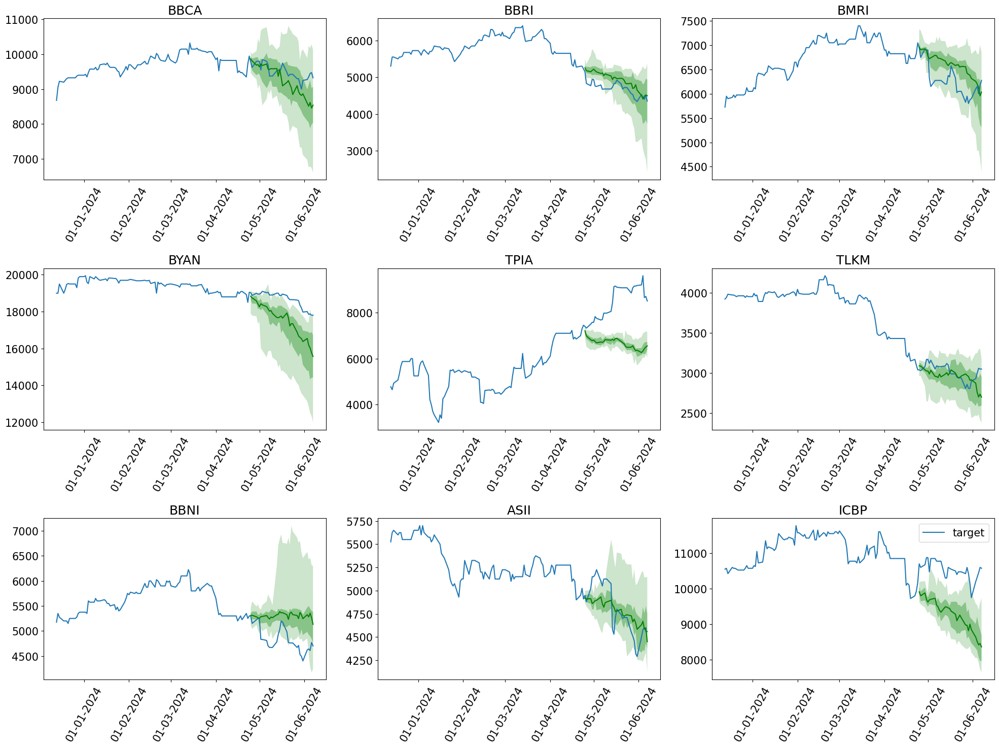

In [128]:
plotting(forecasts_fine_tuning_len_64_lr_5e_5, tss_fine_tuning_len_64_lr_5e_5)

### Get predictions with the default context length ***(128)***

In [129]:
forecasts_fine_tuning_len_128_lr_5e_5, tss_fine_tuning_len_128_lr_5e_5, agg_metrics = lag_llama_fine_tuning(128, 5e-5)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 6.93596 (best 6.93596), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_280\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.50191 (best 6.50191), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_280\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.44563 (best 6.44563), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_280\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 6.44532 (best 6.44532), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_280\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' reached 6.42984 (best 6.42984), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [130]:
fine_tuning_len_128_lr_5e_5 = print_crps_fine_tuning(128, 5e-5, agg_metrics)

Lag-Llama Fine-Tuning (128) Lr 5e-05 CRPS: 0.1192


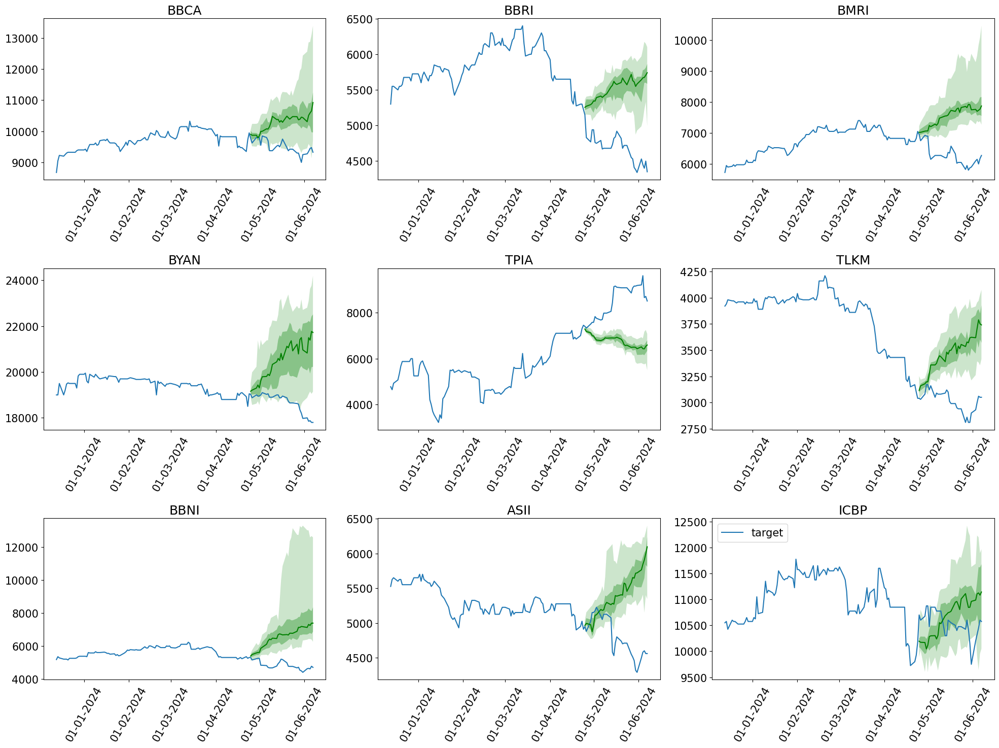

In [131]:
plotting(forecasts_fine_tuning_len_128_lr_5e_5, tss_fine_tuning_len_128_lr_5e_5)

### Get predictions with the default context length ***(256)***

In [132]:
forecasts_fine_tuning_len_256_lr_5e_5, tss_fine_tuning_len_256_lr_5e_5, agg_metrics = lag_llama_fine_tuning(256, 5e-5)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 6.96946 (best 6.96946), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_281\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.50932 (best 6.50932), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_281\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.49038 (best 6.49038), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_281\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.46238 (best 6.46238), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_281\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 6.46073 (best 6.46073), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_281\\checkpoints\\epoch=4-step=250.ckpt' as top

In [133]:
fine_tuning_len_256_lr_5e_5 = print_crps_fine_tuning(256, 5e-5, agg_metrics)

Lag-Llama Fine-Tuning (256) Lr 5e-05 CRPS: 0.0724


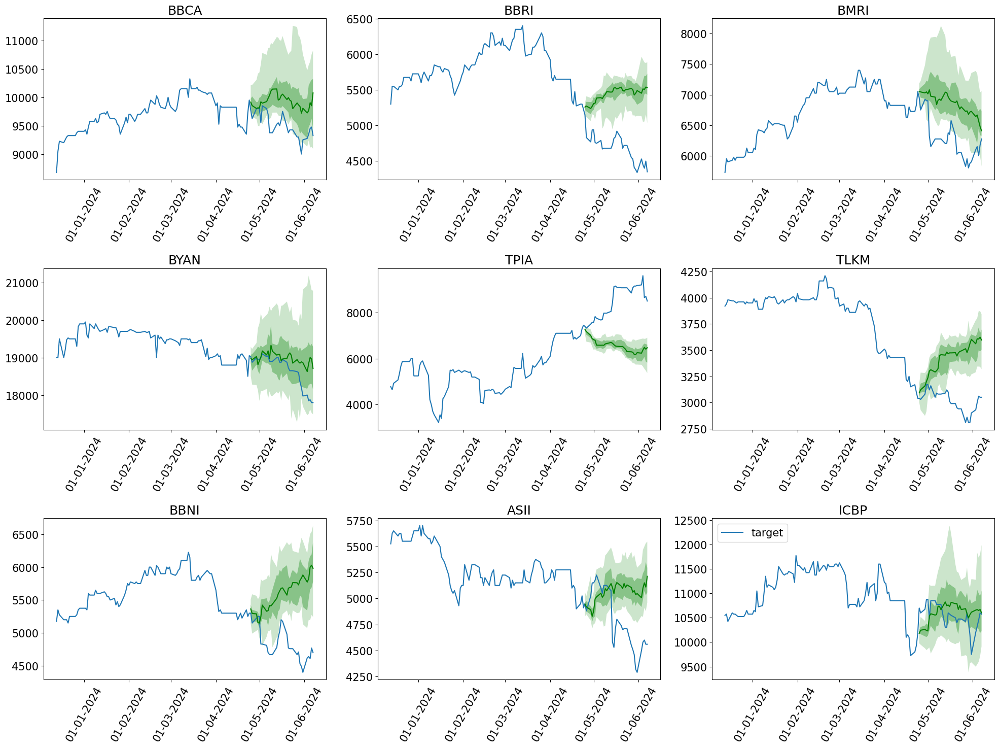

In [134]:
plotting(forecasts_fine_tuning_len_256_lr_5e_5, tss_fine_tuning_len_256_lr_5e_5)

### Get predictions with the default context length ***(512)***

In [135]:
forecasts_fine_tuning_len_512_lr_5e_5, tss_fine_tuning_len_512_lr_5e_5, agg_metrics = lag_llama_fine_tuning(512, 5e-5)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 6.88144 (best 6.88144), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_282\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.54706 (best 6.54706), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_282\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.47699 (best 6.47699), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_282\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.45832 (best 6.45832), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_282\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' was not in top 1
Epoch 5, global step 300: 'train_loss' reached 6.44109 (best 6.44109), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\

In [136]:
fine_tuning_len_512_lr_5e_5 = print_crps_fine_tuning(512, 5e-5, agg_metrics)

Lag-Llama Fine-Tuning (512) Lr 5e-05 CRPS: 0.0842


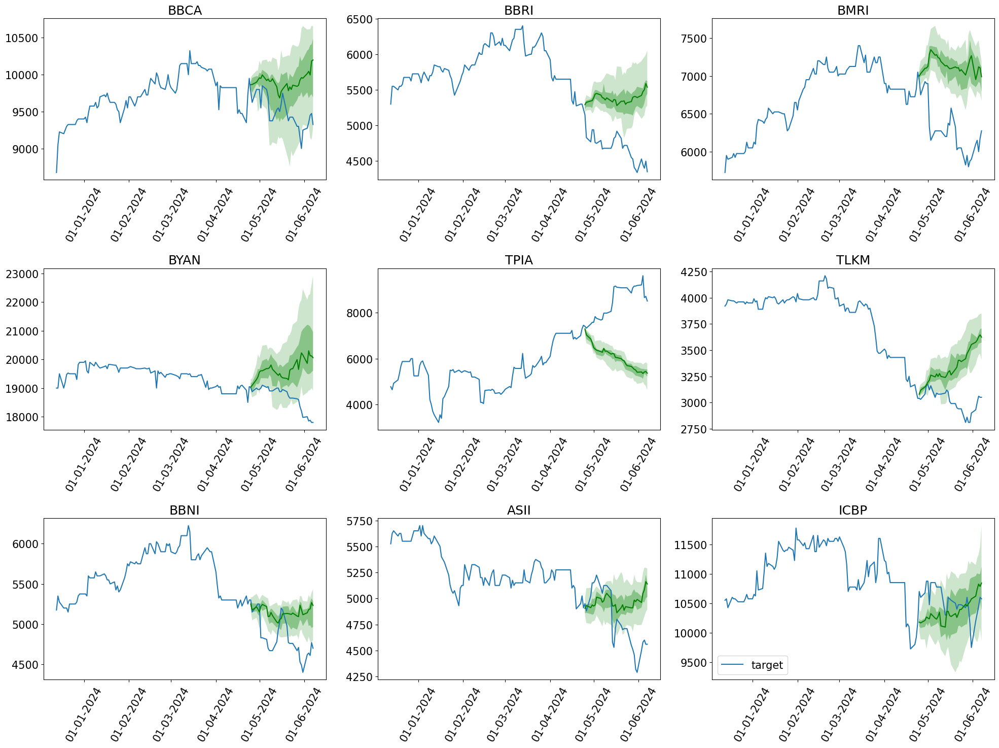

In [137]:
plotting(forecasts_fine_tuning_len_512_lr_5e_5, tss_fine_tuning_len_512_lr_5e_5)

### Get predictions with the default context length ***(1024)***

In [138]:
forecasts_fine_tuning_len_1024_lr_5e_5, tss_fine_tuning_len_1024_lr_5e_5, agg_metrics = lag_llama_fine_tuning(1024, 5e-5)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type               | Params
-----------------------------------------------------
0 | model         | LagLlamaModel      | 2.4 M 
1 | augmentations | ApplyAugmentations | 0     
-----------------------------------------------------
2.4 M     Trainable params
0         Non-trainable params
2.4 M     Total params
9.797     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 6.99692 (best 6.99692), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_283\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 6.60492 (best 6.60492), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_283\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 6.53191 (best 6.53191), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_283\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' reached 6.50831 (best 6.50831), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_283\\checkpoints\\epoch=3-step=200.ckpt' as top 1
Epoch 4, global step 250: 'train_loss' reached 6.48991 (best 6.48991), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_283\\checkpoints\\epoch=4-step=250.ckpt' as top

In [139]:
fine_tuning_len_1024_lr_5e_5 = print_crps_fine_tuning(1024, 5e-5, agg_metrics)

Lag-Llama Fine-Tuning (1024) Lr 5e-05 CRPS: 0.0709


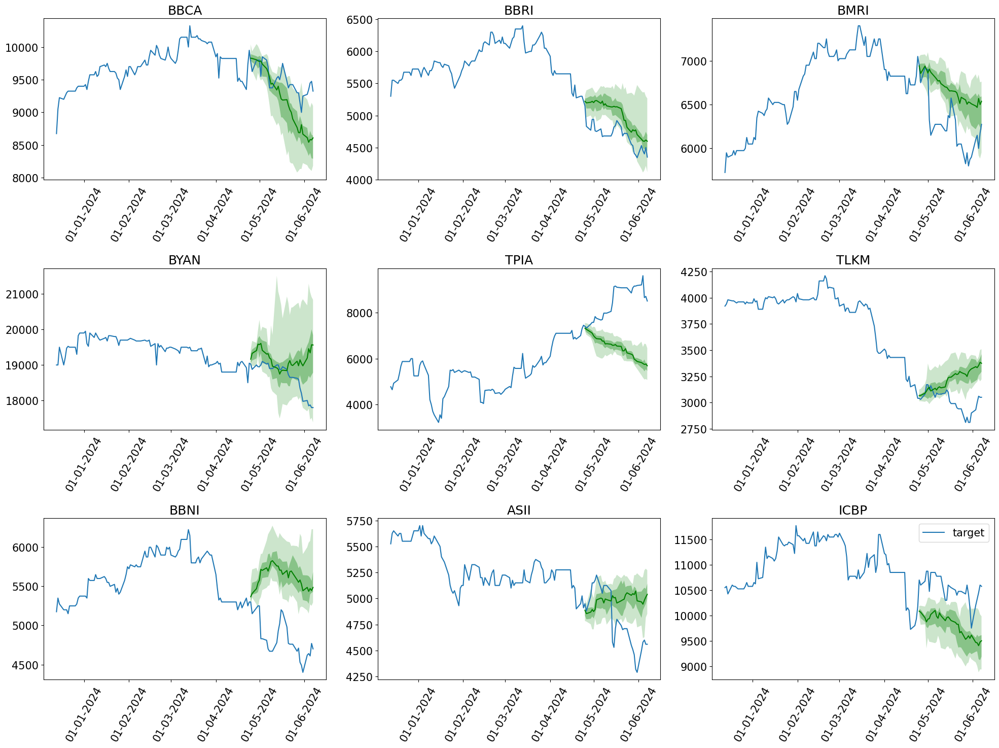

In [140]:
plotting(forecasts_fine_tuning_len_1024_lr_5e_5, tss_fine_tuning_len_1024_lr_5e_5)

# **Compared to TFT and DeepAR**

In [141]:
tft_estimator = TemporalFusionTransformerEstimator(
    prediction_length=prediction_length,
    context_length=32,
    freq="B",
    batch_size=batch_size,
    trainer_kwargs={"max_epochs": epoch}
)
deepar_estimator = DeepAREstimator(
    prediction_length=prediction_length,
    context_length=32,
    freq="B",
    batch_size=batch_size,
    trainer_kwargs={"max_epochs": epoch}
)

In [142]:
tft_predictor = tft_estimator.train(backtrain_dataset)
deepar_predictor = deepar_estimator.train(backtrain_dataset)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name  | Type                           | Params | In sizes                                                                           | Out sizes 
-----------------------------------------------------------------------------------------------------------------------------------------------------------
0 | model | TemporalFusionTransformerModel | 109 K  | [[1, 32], [1, 32], [1, 1], [1, 1], [1, 64, 3], [1, 64, 0], [1, 32, 0], [1, 32, 0]] | [1, 9, 32]
-----------------------------------------------------------------------------------------------------------------------------------------------------------
109 K     Trainable params
0         Non-trainable params
109 K     Total params
0.439     Total estimated model params size (MB)


Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 9313.08398 (best 9313.08398), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_284\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 8231.65332 (best 8231.65332), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_284\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' was not in top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 7516.29736 (best 7516.29736), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_284\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' was not in top 1
Epoch 7, global step 400: 'train_loss' reached 7490.29053 (best 7490.29053), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_

Training: |                                                                                      | 0/? [00:00<…

Epoch 0, global step 50: 'train_loss' reached 8.96078 (best 8.96078), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_285\\checkpoints\\epoch=0-step=50.ckpt' as top 1
Epoch 1, global step 100: 'train_loss' reached 7.91558 (best 7.91558), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_285\\checkpoints\\epoch=1-step=100.ckpt' as top 1
Epoch 2, global step 150: 'train_loss' reached 7.81456 (best 7.81456), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_285\\checkpoints\\epoch=2-step=150.ckpt' as top 1
Epoch 3, global step 200: 'train_loss' was not in top 1
Epoch 4, global step 250: 'train_loss' reached 7.61913 (best 7.61913), saving model to 'D:\\jupyter\\lag-llama-git\\lag-llama\\lightning_logs\\version_285\\checkpoints\\epoch=4-step=250.ckpt' as top 1
Epoch 5, global step 300: 'train_loss' was not in top 1
Epoch 6, global step 350: 'train_loss' reached 7.44658 (best 7.44658), saving model to

In [143]:
tft_forecast_it, tft_ts_it = make_evaluation_predictions(
    dataset=backtest_dataset,
    predictor=tft_predictor,
)

deepar_forecast_it, deepar_ts_it = make_evaluation_predictions(
    dataset=backtest_dataset,
    predictor=deepar_predictor,
)

tft_forecasts = list(tft_forecast_it)
tft_tss = list(tft_ts_it)

deepar_forecasts = list(deepar_forecast_it)
deepar_tss = list(deepar_ts_it)

evaluator = Evaluator()
tft_agg_metrics, tft_ts_metrics = evaluator(iter(tft_tss), iter(tft_forecasts))
deepar_agg_metrics, deepar_ts_metrics = evaluator(iter(deepar_tss), iter(deepar_forecasts))

Running evaluation: 0it [00:00, ?it/s]The mean prediction is not stored in the forecast data; the median is being returned instead. This behaviour may change in the future.
The mean prediction is not stored in the forecast data; the median is being returned instead. This behaviour may change in the future.
The mean prediction is not stored in the forecast data; the median is being returned instead. This behaviour may change in the future.
The mean prediction is not stored in the forecast data; the median is being returned instead. This behaviour may change in the future.
The mean prediction is not stored in the forecast data; the median is being returned instead. This behaviour may change in the future.
The mean prediction is not stored in the forecast data; the median is being returned instead. This behaviour may change in the future.
The mean prediction is not stored in the forecast data; the median is being returned instead. This behaviour may change in the future.
The mean predicti

In [144]:
print(f"Temporal Fusion Transformer CRPS: {tft_agg_metrics['mean_wQuantileLoss']:.4f}")

Temporal Fusion Transformer CRPS: 0.0517


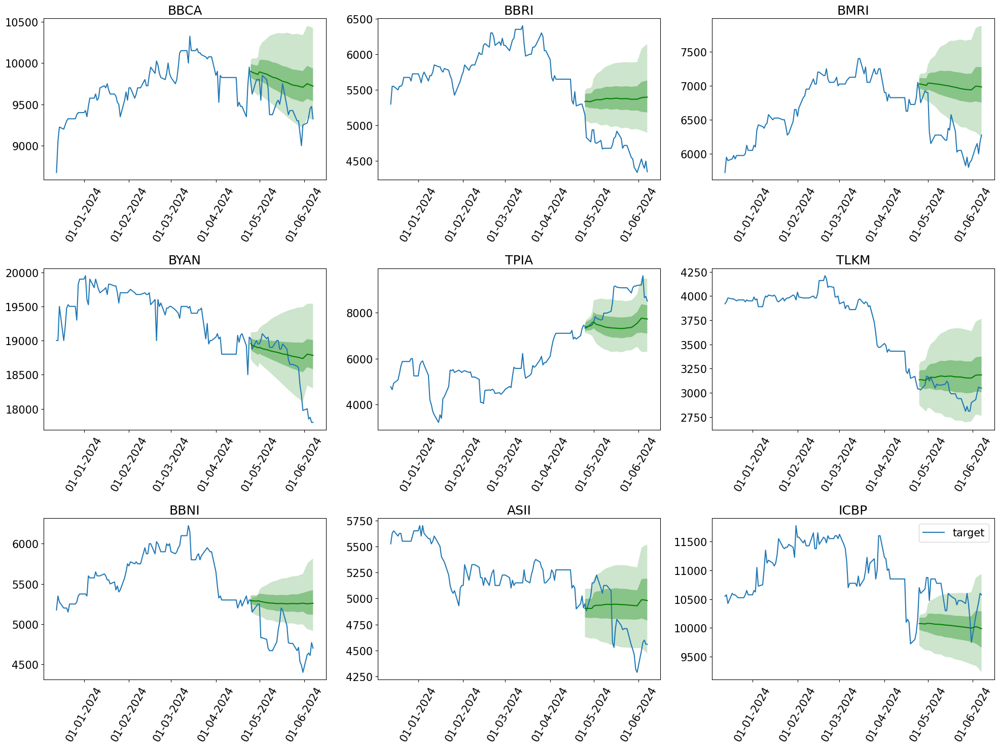

In [145]:
plotting(tft_forecasts, tft_tss)

In [146]:
print(f"DeepAR CRPS: {deepar_agg_metrics['mean_wQuantileLoss']:.4f}")

DeepAR CRPS: 0.0677


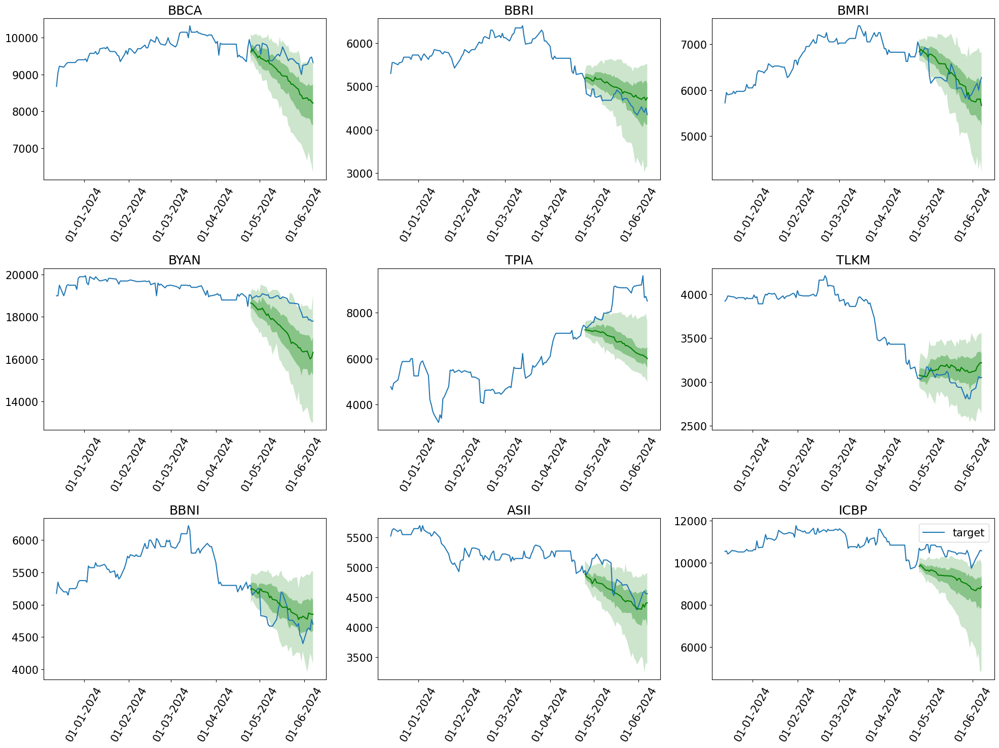

In [147]:
plotting(deepar_forecasts, deepar_tss)

# **Summary**

In [148]:
context_length = [32, 64, 128, 256, 512, 1024]
learning_rates = ['1e-2', '1e-3', '1e-4', '5e-3', '5e-4', '5e-5']

print("\n\033[1mLag-Llama Zero-Shot\033[0m")

# Lag-Llama Zero-Shot (False)
print("\n\033[1mRope scaled (False)\033[0m")
for length in context_length[:2]:
    print(f"Lag-Llama Zero-Shot ({length}) rope_scaled (False) CRPS: {globals()[f'zero_shot_len_{length}_false']:.4f}")

# Lag-Llama Zero-Shot (True)
print("\n\033[1mRope scaled (True)\033[0m")
for length in context_length[1:]:
    print(f"Lag-Llama Zero-Shot ({length}) rope_scaled (True) CRPS: {globals()[f'zero_shot_len_{length}_true']:.4f}")

# Lag-Llama Fine-Tuning
print("\n\033[1mLag-Llama Fine-Tuning\033[0m")
for lr in learning_rates:
    print(f"\n\033[1mLearning rate {lr}\033[0m")
    for length in context_length:
        variable_name = f"fine_tuning_len_{length}_lr_{lr.replace('-', '_')}"
        print(f"Lag-Llama Fine-Tuning ({length}) Lr {lr} CRPS: {globals()[variable_name]:.4f}")


print("\n\033[1mComparation Temporal Fusion Transformer (TFT) and DeepAR\033[0m")
print(f"Temporal Fusion Transformer CRPS: {tft_agg_metrics['mean_wQuantileLoss']:.4f}")
print(f"DeepAR CRPS: {deepar_agg_metrics['mean_wQuantileLoss']:.4f}")


Lag-Llama Zero-Shot

Rope scaled (False)
Lag-Llama Zero-Shot (32) rope_scaled (False) CRPS: 0.0890
Lag-Llama Zero-Shot (64) rope_scaled (False) CRPS: 0.0980

Rope scaled (True)
Lag-Llama Zero-Shot (64) rope_scaled (True) CRPS: 0.0927
Lag-Llama Zero-Shot (128) rope_scaled (True) CRPS: 0.0890
Lag-Llama Zero-Shot (256) rope_scaled (True) CRPS: 0.0973
Lag-Llama Zero-Shot (512) rope_scaled (True) CRPS: 0.1330
Lag-Llama Zero-Shot (1024) rope_scaled (True) CRPS: 0.1515

Lag-Llama Fine-Tuning

Learning rate 1e-2
Lag-Llama Fine-Tuning (32) Lr 1e-2 CRPS: 0.0674
Lag-Llama Fine-Tuning (64) Lr 1e-2 CRPS: 0.1220
Lag-Llama Fine-Tuning (128) Lr 1e-2 CRPS: 0.1088
Lag-Llama Fine-Tuning (256) Lr 1e-2 CRPS: 0.1072
Lag-Llama Fine-Tuning (512) Lr 1e-2 CRPS: 0.0803
Lag-Llama Fine-Tuning (1024) Lr 1e-2 CRPS: 0.0628

Learning rate 1e-3
Lag-Llama Fine-Tuning (32) Lr 1e-3 CRPS: 0.2405
Lag-Llama Fine-Tuning (64) Lr 1e-3 CRPS: 0.1050
Lag-Llama Fine-Tuning (128) Lr 1e-3 CRPS: 0.1050
Lag-Llama Fine-Tuning (256) Lr 

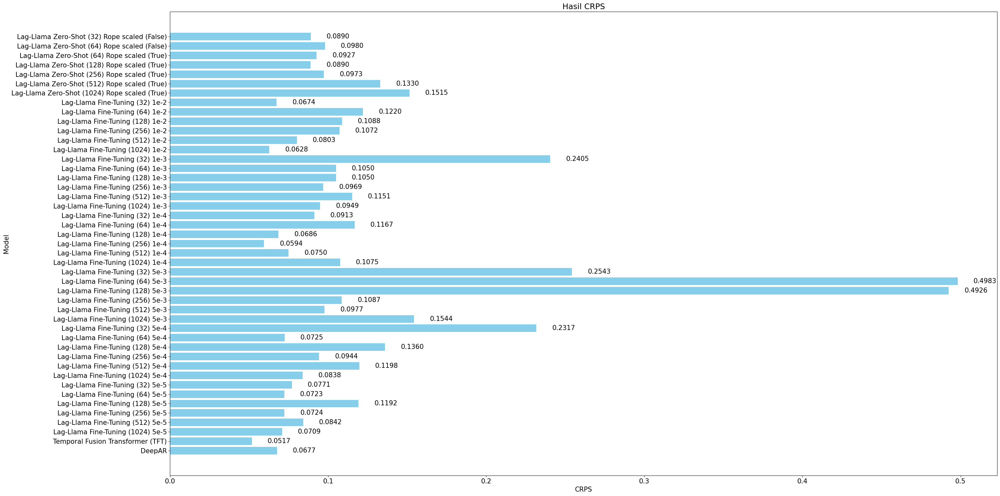

In [155]:
import matplotlib.pyplot as plt

def collect_crps_data(results):
    models, crps_values = [], []
    for model, data in results.items():
        if isinstance(data, dict):
            for sub_model, sub_data in data.items():
                for length, crps in sub_data.items():
                    models.append(f"{model} ({length}) {sub_model}")
                    crps_values.append(crps)
        else:
            models.append(model)
            crps_values.append(data)
    return models, crps_values

results = {
    "Lag-Llama Zero-Shot": {
        "Rope scaled (False)": {length: globals()[f'zero_shot_len_{length}_false'] for length in context_length[:2]},
        "Rope scaled (True)": {length: globals()[f'zero_shot_len_{length}_true'] for length in context_length[1:]}
    },
    "Lag-Llama Fine-Tuning": {
        lr: {length: globals()[f"fine_tuning_len_{length}_lr_{lr.replace('-', '_')}"] for length in context_length}
        for lr in learning_rates
    },
    "Temporal Fusion Transformer (TFT)": tft_agg_metrics['mean_wQuantileLoss'],
    "DeepAR": deepar_agg_metrics['mean_wQuantileLoss']
}

models, crps_values = collect_crps_data(results)
plt.figure(figsize=(32, 16))
bars = plt.barh(models, crps_values, color='skyblue')
plt.xlabel('CRPS')
plt.ylabel('Model')
plt.title('Hasil CRPS')
plt.gca().invert_yaxis()

for bar in bars:
    width = bar.get_width()
    plt.text(width + 0.01, bar.get_y() + bar.get_height() / 2,
             f'{width:.4f}', va='center')

plt.tight_layout()
plt.show()

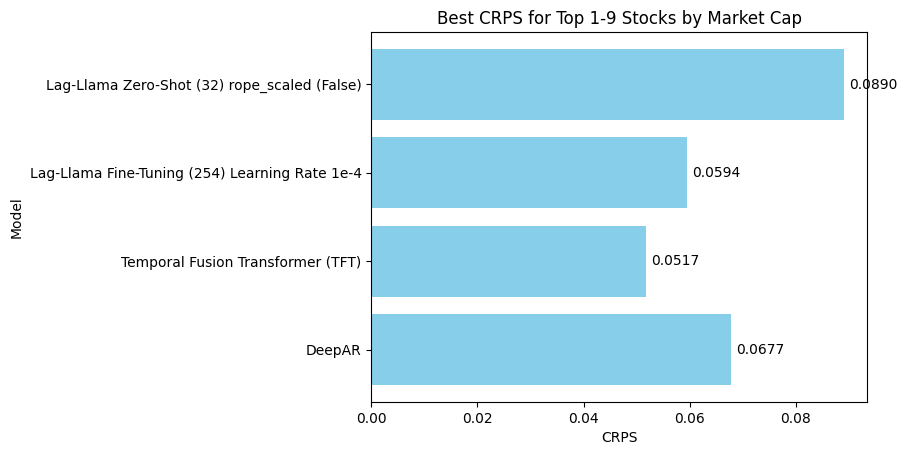

In [2]:
import matplotlib.pyplot as plt

data = {
    "Lag-Llama Zero-Shot (32) rope_scaled (False)": 0.0890,
    "Lag-Llama Fine-Tuning (254) Learning Rate 1e-4": 0.0594,
    "Temporal Fusion Transformer (TFT)": 0.0517,
    "DeepAR": 0.0677
}

models = list(data.keys())
crps_values = list(data.values())
fig, ax = plt.subplots()

bars = ax.barh(models, crps_values, color='skyblue')
plt.xlabel('CRPS')
plt.ylabel('Model')
plt.title('Best CRPS for Top 1-9 Stocks by Market Cap')
plt.gca().invert_yaxis()

for bar in bars:
    width = bar.get_width()
    plt.text(width + 0.001, bar.get_y() + bar.get_height() / 2, f'{width:.4f}', va='center')

plt.show()